# Environment setup

In [1]:
from scipy.io import loadmat
import os
import numpy as np
import mne
import matplotlib.pyplot as plt

# Path to musicImagery dataset
dataDir = r'data/musicImagery/'
#dataDir = r'D:\marion_music_imagery\datasetCND_musicImagery\musicImagery'

In [2]:
%matplotlib widget

In [3]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

// This disables scrolling outputs

<IPython.core.display.Javascript object>

# Load stimuli
Note: ```stimIndxs``` range from 1 to 4 and ```condIdxs``` range from 1-2.
These are _not_ 0-indexed.

In [4]:
stim_mat = loadmat(dataDir+r"/dataCND/dataStim.mat", simplify_cells = True) 
stim = stim_mat['stim']
# print(stim)

stimIdxs = stim['stimIdxs']
print(f'stimIdxs shape (N trials): {stimIdxs.shape}')

condIdxs = stim['condIdxs']
print(f'condIdxs shape (N trials): {condIdxs.shape}')

condNames = stim['condNames']
print(f'condNames shape (P conditions): {condNames.shape}')

stim_events = stim['data']
print(f'events shape (M features, N trials): {stim_events.shape}')

stim_event_labels = stim['names']
print(f'event names shape (M features): {stim_event_labels.shape}')

fs_stim = stim['fs'] # ignore, use fs from data struct (64 Hz)
print(f'fs: {fs_stim} Hz')

stimIdxs shape (N trials): (88,)
condIdxs shape (N trials): (88,)
condNames shape (P conditions): (2,)
events shape (M features, N trials): (2, 88)
event names shape (M features): (2,)
fs: 64 Hz


In [50]:
# Handy mapping of indices to labels
stimId_to_Song_map = {
    2: 'chor-038', 
    1: 'chor-096', 
    3: 'chor-101',
    4: 'chor-019', 
} # from read_stim_midi.ipynb

stimLabel_to_id_map = {
    'chor-038': 2, 
    'chor-096': 1, 
    'chor-101': 3,
    'chor-019': 4, 
} # reverse mapping

stimLabel_to_sheet_order_map = {
    'chor-038': 1, 
    'chor-096': 2, 
    'chor-101': 3,
    'chor-019': 4, 
} # order of songs on sheet music

condId_to_State_map = {
    1: 'Listening', 
    2: 'Imagery'
} # from condNames

# Stim Channel

Finding tactile metronome onsets

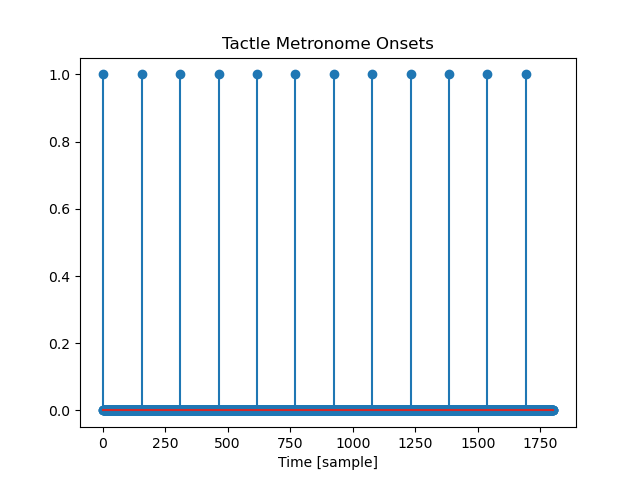

In [6]:
# From Guilhem's note
barOnsets = [1, 157] # in sample indices

cueTime = 310 # third bar
for barIdx in range(10): # 12 bars total
    barOnsets.append(cueTime)
    if barIdx%2 == 1:
        cueTime += 153
    else:
        cueTime += 154
        
cueTime -= 1 # index from 0

# Make a new exp vector for metronome hits
cueExp = np.zeros_like(stim_events[1][0]) # same size as the first expectation vector
cueExp[barOnsets] = 1

plt.figure()
plt.stem(cueExp, '*')
plt.xlabel('Time [sample]')
plt.title('Tactle Metronome Onsets')
plt.show()

Note onsets for stim channel

In [7]:
stim = {}
for stimLabel in [
    'chor-038', 
    'chor-096', 
    'chor-101',
    'chor-019']: # top to bottom on the sheet music

    stim[stimLabel] = {}
    
    # Collect note and beat onsets for current stim
    stimIdx = stimLabel_to_id_map[stimLabel]
    stimExp = stim_events[1][11*(stimIdx-1)] # expectations vector for current stim
    note_onsets = stimExp > 0
    stim[stimLabel]['notes'] = note_onsets
    stim[stimLabel]['beats'] = cueExp

These indices will be used later to identify song and condition for a given subject's trial order:

In [8]:
# Collect stim idxs by condition and song
idxs = {} # dict to store idxs for each condition and stim/song idx

for condIdx in np.unique(condIdxs): # two conditions
    condName = condNames[condIdx-1] # MATLAB indexes from 1...
    idxs[condName] = {}
    
    for stimIdx in np.unique(stimIdxs):
        
        stimName = stimId_to_Song_map[stimIdx]
        
        print(f'{condName}: Song {stimName}: Indices:') 
        matched_ndx = np.where(
            (stimIdxs == stimIdx) & (condIdxs == condIdx)
            )[0]
        print(matched_ndx)
        
        idxs[condName][stimName] = matched_ndx

Listening: Song chor-096: Indices:
[ 0  1  2  3  4  5  6  7  8  9 10]
Listening: Song chor-038: Indices:
[11 12 13 14 15 16 17 18 19 20 21]
Listening: Song chor-101: Indices:
[22 23 24 25 26 27 28 29 30 31 32]
Listening: Song chor-019: Indices:
[33 34 35 36 37 38 39 40 41 42 43]
Imagery: Song chor-096: Indices:
[44 45 46 47 48 49 50 51 52 53 54]
Imagery: Song chor-038: Indices:
[55 56 57 58 59 60 61 62 63 64 65]
Imagery: Song chor-101: Indices:
[66 67 68 69 70 71 72 73 74 75 76]
Imagery: Song chor-019: Indices:
[77 78 79 80 81 82 83 84 85 86 87]


# Load EEG data for a subject

Make a list of raws for each subject, in original trial order

Steps needed:
- Make an MNE info object
    - Add trial condition and song name to raw's description
- Correct channel names for applying biosemi64 montage
- Add a stim channel with note and beat onsets 
    - Note, there are no overlapping events as any notes overlapped with beat onsets are removed from the stim mat files (these can still be recovered from the MIDI if needed)

In [9]:
def merged_raws_for_subject(
        subjectID = 1,
        BEAT_EVENT_MARKER = 1,
        NOTE_EVENT_MARKER = 128,
    ):
    
    # Path to data for selected subject
    sub1_mat = loadmat(dataDir+f"/dataCND/dataSub{subjectID}.mat", simplify_cells = True) 

    # This should be the same as fs_stim above
    fs = sub1_mat['eeg']['fs']

    # EEG dataset for selected subject
    data = sub1_mat['eeg']['data']

    # Randomized trial order for current subject
    orig_trial_pos = sub1_mat['eeg']['origTrialPosition']
    print(f'orig_trial_pos shape: {orig_trial_pos.shape}')

    # Get current subject's song and condition ordering (since its randomized)
    thisSubStimOrder = stimIdxs[(orig_trial_pos-1)] # convert to being zero indexed
    thisSubCondOrder = condIdxs[(orig_trial_pos-1)]

    # EEG channel map
    chanLocs = sub1_mat['eeg']['chanlocs']
    montage_chs = [] # get channel names and order from chanLocs
    for k in chanLocs:
        ch_n = k['labels'].split(' (')[0] # remove paranthesis from name
        montage_chs.append(ch_n)

    # Make an info object
    info = mne.create_info(
            ch_names=montage_chs + ['midi'], 
            sfreq=fs, 
            ch_types=['eeg']*len(chanLocs) + ['stim']
        )
    info.set_montage('biosemi64', match_case=False) # resolves Afz case trouble

    raw_trials = []
    for trialIdx in orig_trial_pos-1: # go back to original trial order

        # What stim and condition (state) is this trial?
        stimIdx = thisSubStimOrder[trialIdx]
        condIdx = thisSubCondOrder[trialIdx]

        info['description'] = str(trialIdx) #f'{condId_to_State_map[condIdx]}/{stimId_to_Song_map[stimIdx]}'
        
        stimLabel = stimId_to_Song_map[stimIdx]
        stim_data = NOTE_EVENT_MARKER * stim[stimLabel]['notes'] + BEAT_EVENT_MARKER * stim[stimLabel]['beats']
        print(stim_data.shape)
        print(data[trialIdx].shape)

        # Rescale data to Volts, Add the stim channel
        eeg_and_stim_data = np.vstack((data[trialIdx].T / 1e6, stim_data))
        
        raw = mne.io.RawArray(
            data = eeg_and_stim_data, # transpose for importing to MNE
            info = info,
        )

        raw_trials.append(raw)

    return raw_trials

List of raws, in original trial order, by subject

In [10]:
raw_trials = {}
for subjectID in [1, 3, 7, 11]:
    raw_trials[subjectID] = merged_raws_for_subject(subjectID = subjectID)

orig_trial_pos shape: (88,)
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.
(1803,)
(1803, 64)
Creating RawArray with float64 data, n_channels=65, n_times=1803
    Range : 

In [11]:
for subjectID in raw_trials:
    for raw in raw_trials[1]:
        trialIdx = int(raw.info['description'])
        stimLabel = stimId_to_Song_map[stimIdxs[trialIdx]]
        condLabel = condId_to_State_map[condIdxs[trialIdx]]
        print(f"sub{subjectID}\ttrial-{raw.info['description']}\t{condLabel}\t{stimLabel}")

sub1	trial-2	Listening	chor-096
sub1	trial-8	Listening	chor-096
sub1	trial-14	Listening	chor-038
sub1	trial-15	Listening	chor-038
sub1	trial-26	Listening	chor-101
sub1	trial-27	Listening	chor-101
sub1	trial-29	Listening	chor-101
sub1	trial-36	Listening	chor-019
sub1	trial-47	Imagery	chor-096
sub1	trial-48	Imagery	chor-096
sub1	trial-52	Imagery	chor-096
sub1	trial-3	Listening	chor-096
sub1	trial-6	Listening	chor-096
sub1	trial-11	Listening	chor-038
sub1	trial-28	Listening	chor-101
sub1	trial-33	Listening	chor-019
sub1	trial-34	Listening	chor-019
sub1	trial-37	Listening	chor-019
sub1	trial-51	Imagery	chor-096
sub1	trial-58	Imagery	chor-038
sub1	trial-62	Imagery	chor-038
sub1	trial-70	Imagery	chor-101
sub1	trial-7	Listening	chor-096
sub1	trial-10	Listening	chor-096
sub1	trial-21	Listening	chor-038
sub1	trial-23	Listening	chor-101
sub1	trial-30	Listening	chor-101
sub1	trial-35	Listening	chor-019
sub1	trial-38	Listening	chor-019
sub1	trial-39	Listening	chor-019
sub1	trial-66	Imagery	chor-10

# Compare EOG event finding between scalp and ICA domains

## EOG events from scalp

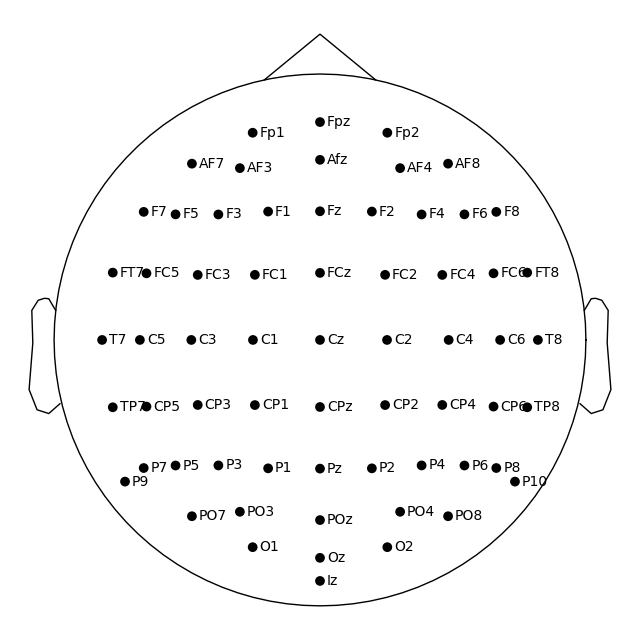

Using EOG channels: Fpz, Fp1, Fp2, AF7, AF3, Afz, AF4, AF8
EOG channel index for this subject is: [ 0  1  2 32 33 34 35 36]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 640 samples (10.000 sec)

Now detecting blinks and generating corresponding events
Found 11 significant peaks
Number of EOG events detected: 11
Using matplotlib as 2D backend.


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


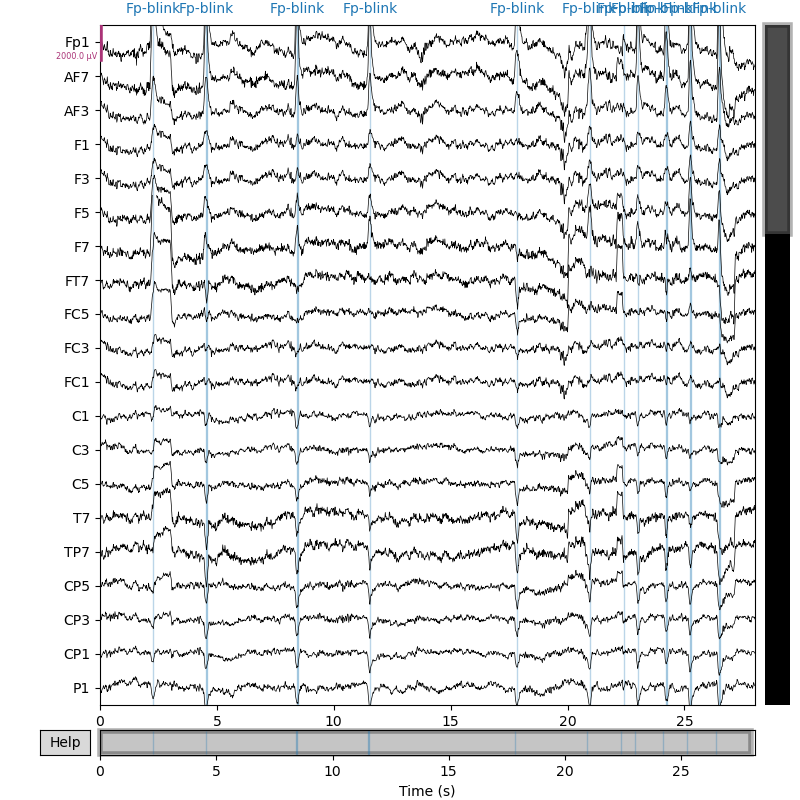

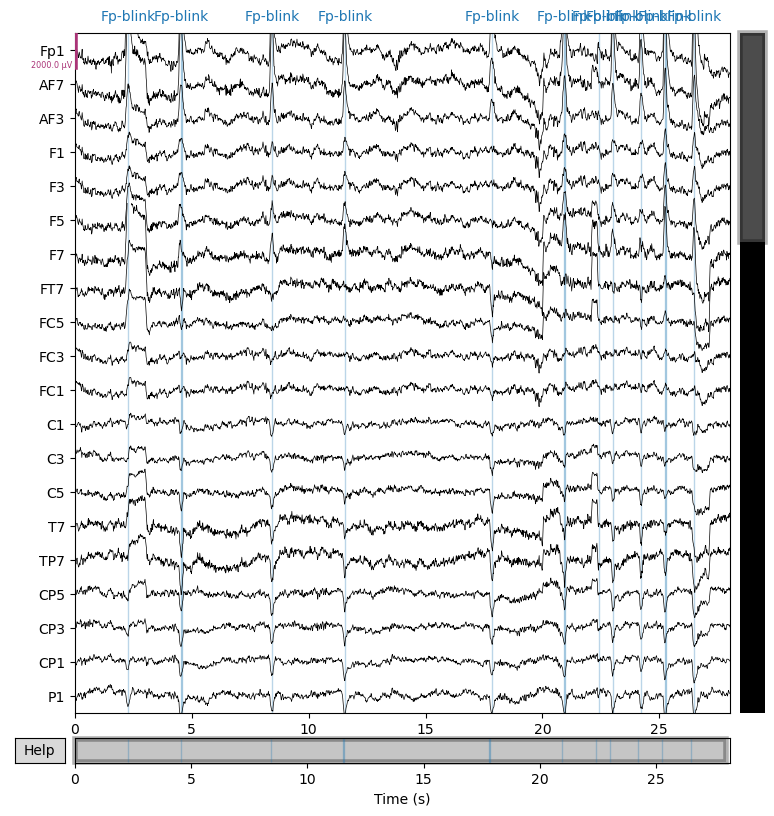

In [12]:
raw = raw_trials[1][0]
mne.viz.plot_montage(raw.info.get_montage())

eog_event_id = 2
eog_events = mne.preprocessing.find_eog_events(
    raw,
    event_id = eog_event_id,
    ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
)

eog_annots = mne.annotations_from_events(
    eog_events,
    sfreq = raw.info['sfreq'],
    event_desc = {eog_event_id: "Fp-blink"},
)
raw.set_annotations(eog_annots)

#raw.add_events(eog_events)

scalings = {'eeg': 1e-3}
raw.plot(
    duration = 28,
    scalings = scalings
)

## EOG events from ICA source

### Run ICA

In [13]:
# from mne_icalabel import label_components

Try ICA on epochs, where each epoch is one meaesure (4 beats)

In [14]:
events = mne.find_events(
    raw, 
    initial_event=True,
    shortest_event=1,
)

40 events found
Event IDs: [  1 128]


In [15]:
events

array([[   1,    0,    1],
       [ 115,    0,  128],
       [ 157,    0,    1],
       [ 192,    0,  128],
       [ 230,    0,  128],
       [ 310,    0,    1],
       [ 345,    0,  128],
       [ 384,    0,  128],
       [ 422,    0,  128],
       [ 464,    0,    1],
       [ 499,    0,  128],
       [ 537,    0,  128],
       [ 576,    0,  128],
       [ 617,    0,    1],
       [ 633,    0,  128],
       [ 652,    0,  128],
       [ 691,    0,  128],
       [ 729,    0,  128],
       [ 771,    0,    1],
       [ 883,    0,  128],
       [ 902,    0,  128],
       [ 924,    0,    1],
       [ 960,    0,  128],
       [ 998,    0,  128],
       [1036,    0,  128],
       [1078,    0,    1],
       [1152,    0,  128],
       [1190,    0,  128],
       [1231,    0,    1],
       [1267,    0,  128],
       [1305,    0,  128],
       [1344,    0,  128],
       [1385,    0,    1],
       [1459,    0,  128],
       [1497,    0,  128],
       [1538,    0,    1],
       [1574,    0,  128],
 

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 31.00 Hz)
- Filter length: 213 samples (3.328 sec)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Not setting metadata
40 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Fitting ICA to data using 64 channels (please be patient, this may take a while)
Using data from preloaded Raw for 12 events and 155 original time points ...
1 bad epochs dropped
Selecting by number: 63 compone

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  64 out of  64 | elapsed:    0.0s finished
/var/folders/st/wjnxghxn7_b382gv3l4lxt0m0000gn/T/ipykernel_29620/2291761077.py:26: RuntimeWarning: The epochs you passed to ICA.fit() were baseline-corrected. However, we suggest to fit ICA only on data that has been high-pass filtered, but NOT baseline-corrected.
  ica.fit(


Using data from preloaded Raw for 11 events and 155 original time points ...
Fitting ICA took 0.9s.
Using data from preloaded Raw for 12 events and 155 original time points ...
1 bad epochs dropped
Not setting metadata
11 matching events found
No baseline correction applied
0 projection items activated


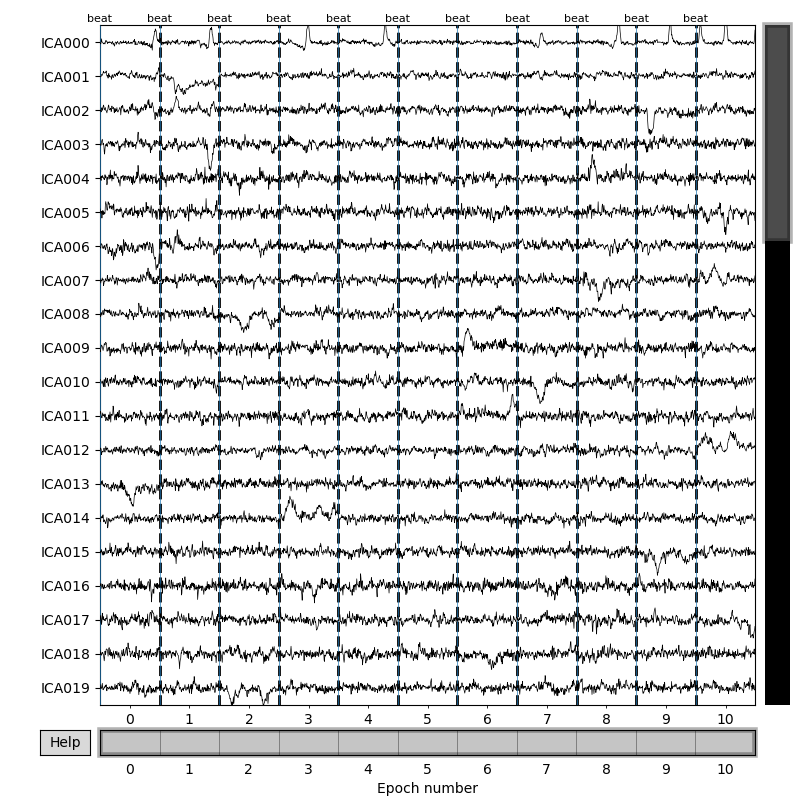

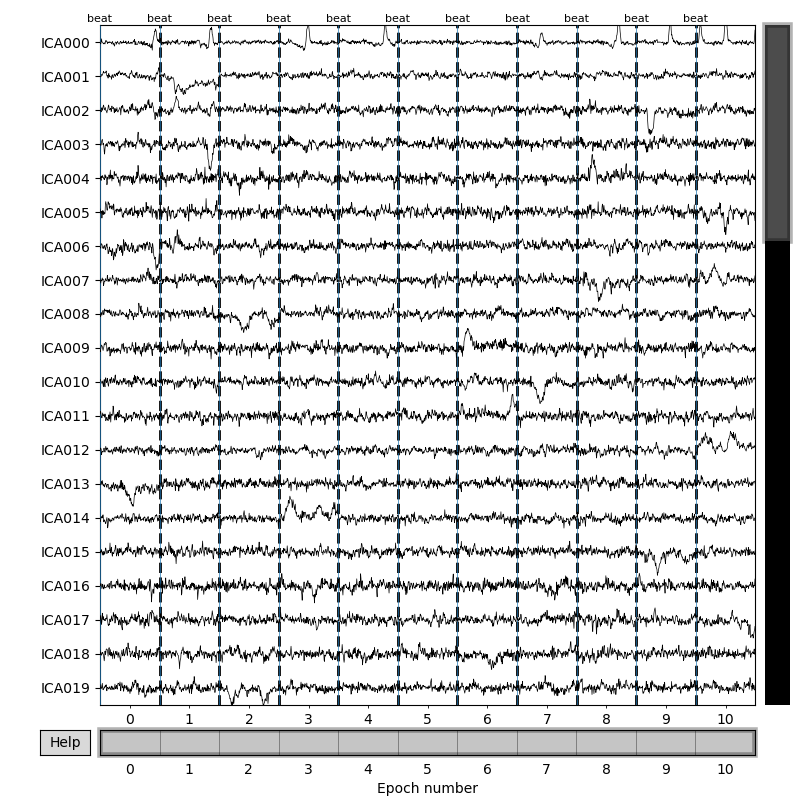

In [16]:
%matplotlib widget

raw_filt = raw.copy().filter( # ica-label needs 1-100Hz
    l_freq=1, 
    h_freq=30,
)
#mne.viz.plot_montage(raw.info.get_montage())

raw_filt.set_eeg_reference('average')

ica = mne.preprocessing.ICA(
    n_components = 63,
    # method='infomax', # needed by ica-label, but takes longer to run than fastica (default)
)

eps = mne.Epochs(
    raw_filt,
    events = events,
    baseline = (0, 0.1),
    event_id = {'beat': 1, 'note': 128},
    tmin = 0,
    tmax = 4 * (60/100), # 2.4 seconds, 4 beats,
    reject_by_annotation=False,
)

ica.fit(
    eps['beat'],
    reject = None,
    reject_by_annotation=False,
)
#ica_sources = ica.apply(raw_filt)

# assuming you have a Raw and ICA instance previously fitted
# label_components(raw_filt, ica, method='iclabel')

ica.plot_sources(eps['beat'])
plt.show()

Using data from preloaded Raw for 11 events and 155 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
11 matching events found
No baseline correction applied
0 projection items activated


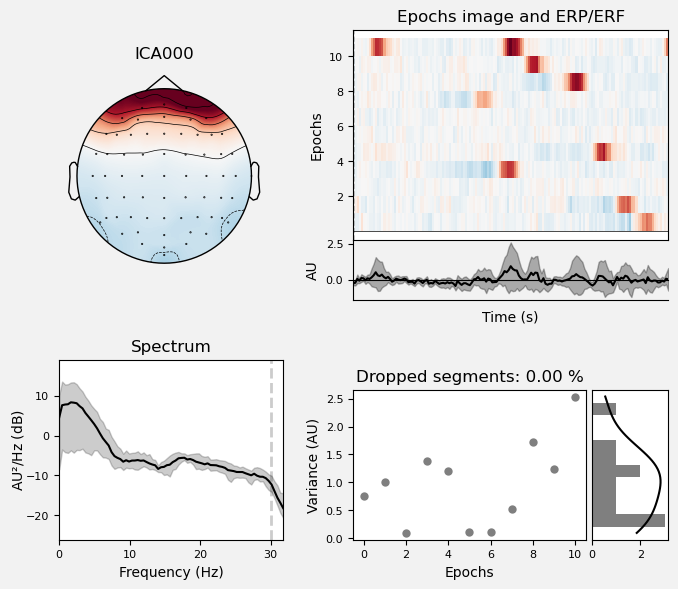

Using data from preloaded Raw for 11 events and 155 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
11 matching events found
No baseline correction applied
0 projection items activated


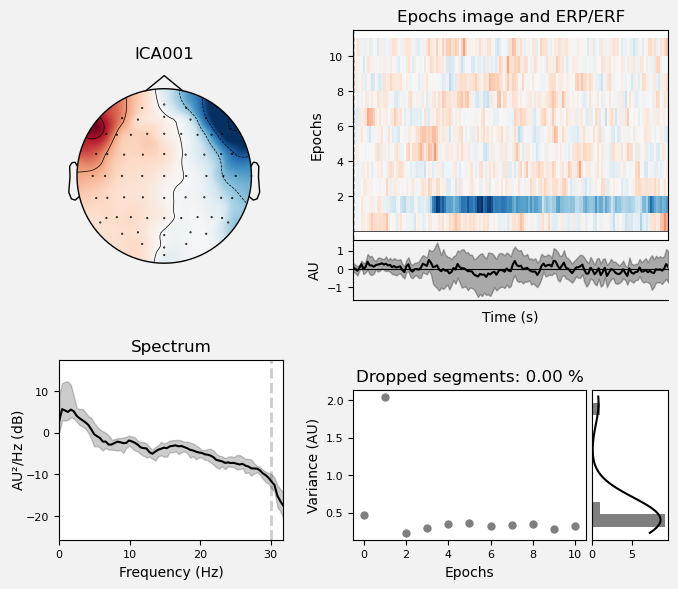

Using data from preloaded Raw for 11 events and 155 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
11 matching events found
No baseline correction applied
0 projection items activated


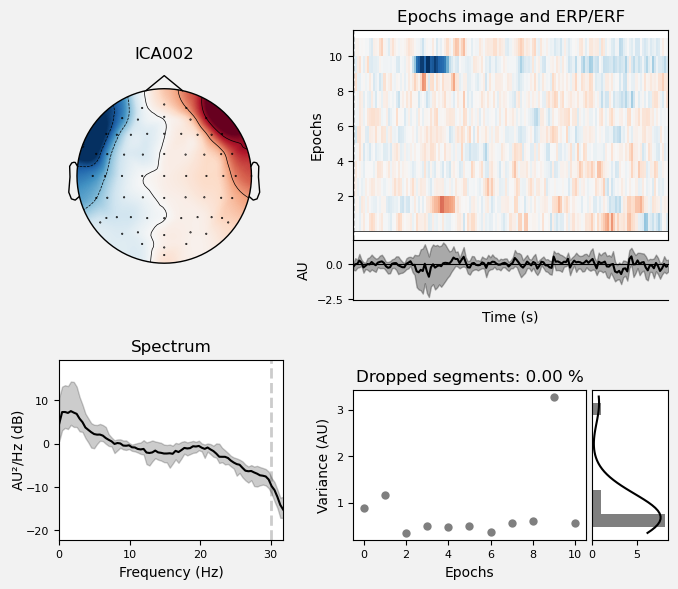

Using data from preloaded Raw for 11 events and 155 original time points ...
0 bad epochs dropped
0 bad epochs dropped
    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
11 matching events found
No baseline correction applied
0 projection items activated


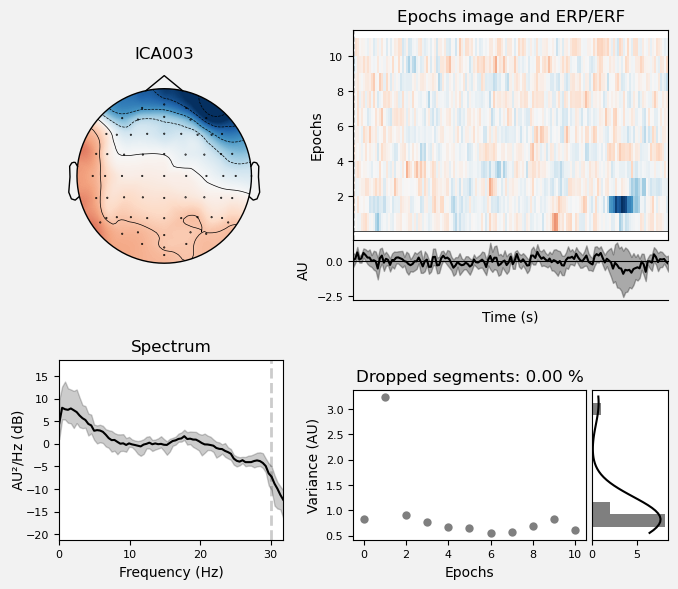

In [17]:
%matplotlib inline 

for ica_chan in [0, 1, 2, 3]:
    ica.plot_properties(
        eps['beat'][:-1], # because one epoch got dropped?
        picks = [ica_chan],
        #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
    )
    plt.show()

Using epochs is dropping one epoch -- which might be the bar change between the two lines of sheet music per song?

Do not epoch for ICA:

Fitting ICA to data using 64 channels (please be patient, this may take a while)
Selecting by number: 63 components
Fitting ICA took 1.5s.
Creating RawArray with float64 data, n_channels=63, n_times=1803
    Range : 0 ... 1802 =      0.000 ...    28.156 secs
Ready.


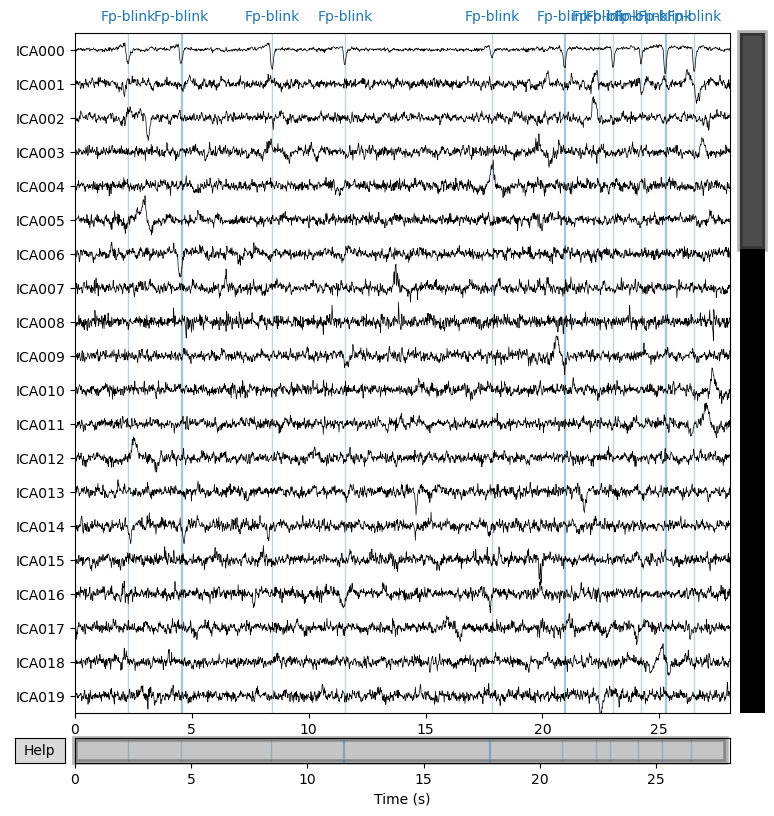

In [18]:
ica.fit(
    raw_filt,
    reject = None,
    reject_by_annotation=False,
)

ica.plot_sources(
    raw_filt,
    start = 0,
    stop = 28,
)
plt.show()

In [19]:
# https://mne.tools/stable/auto_tutorials/preprocessing/40_artifact_correction_ica.html#using-an-eog-channel-to-select-ica-components

# find which ICs match the EOG pattern
eog_indices, eog_scores = ica.find_bads_eog(
    raw_filt,
    # skip filtering again since we are already using 1-10Hz BPF
    l_freq = None, 
    h_freq = None, 
    ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
)

print(eog_indices, eog_scores)

Using EOG channels: Fpz, Fp1, Fp2, AF7, AF3, Afz, AF4, AF8
[0] [array([-9.26775172e-01, -1.45319243e-01,  4.18448015e-02, -6.69201670e-02,
        1.20627343e-01, -1.05131707e-02, -1.25820883e-01, -1.00427088e-01,
        1.98424792e-02, -7.72007968e-02, -6.71596645e-02,  1.78697734e-02,
        3.37768323e-02, -6.14709080e-02, -7.45134419e-02,  4.34448660e-02,
       -7.29240791e-02,  2.74572767e-02, -4.13788534e-02, -1.40257050e-02,
       -7.74395493e-02, -3.81453408e-02,  5.98713265e-03,  2.48373446e-02,
        2.92281807e-02,  6.04683403e-02, -6.09777537e-02, -3.40969322e-02,
        3.44452744e-02, -3.26427707e-02, -3.03168107e-02, -6.53085101e-02,
        5.07752788e-02,  4.58689976e-02, -7.57983292e-04, -4.87792203e-02,
       -1.89757301e-02, -1.39201670e-02, -2.14736009e-02, -1.78690109e-05,
       -4.59386123e-02,  7.68468292e-03, -1.33603322e-02,  1.62972576e-02,
       -1.37215177e-02, -2.81461618e-02,  1.55961007e-02, -3.15990212e-02,
        1.65645225e-03,  1.08111822e

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated


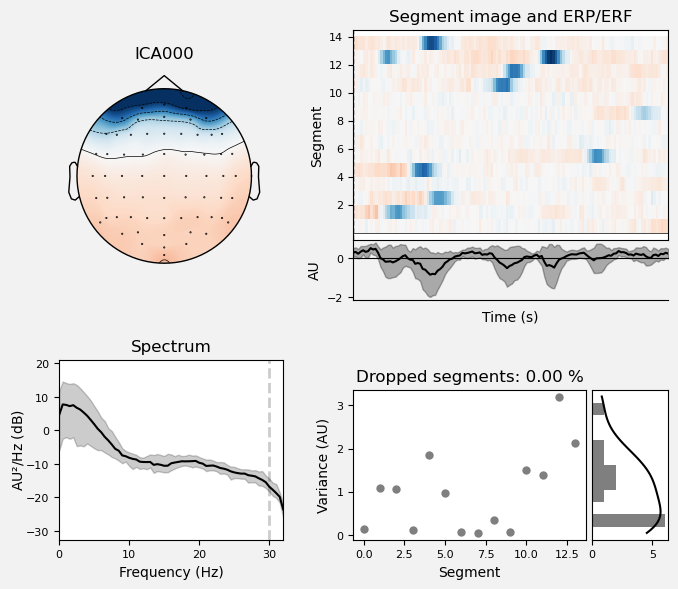

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated


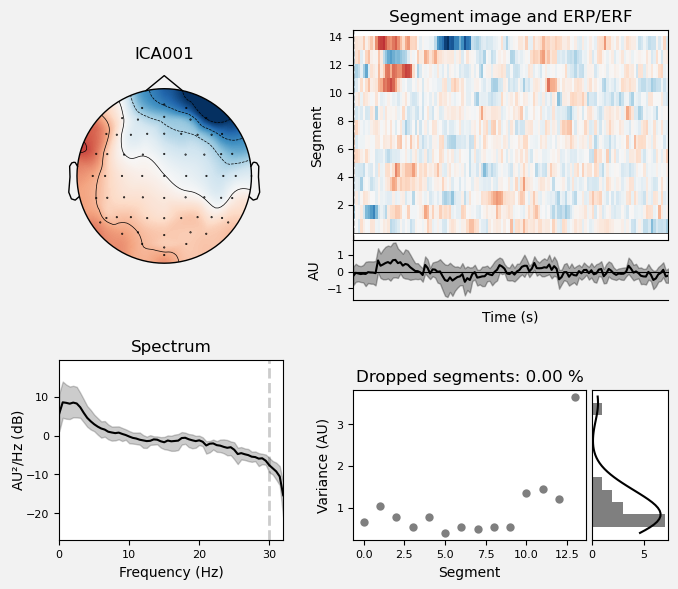

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated


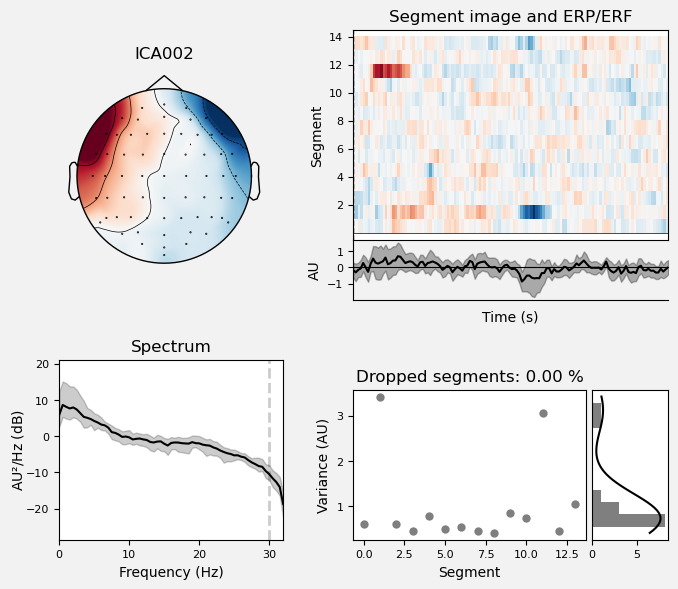

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
14 matching events found
No baseline correction applied
0 projection items activated


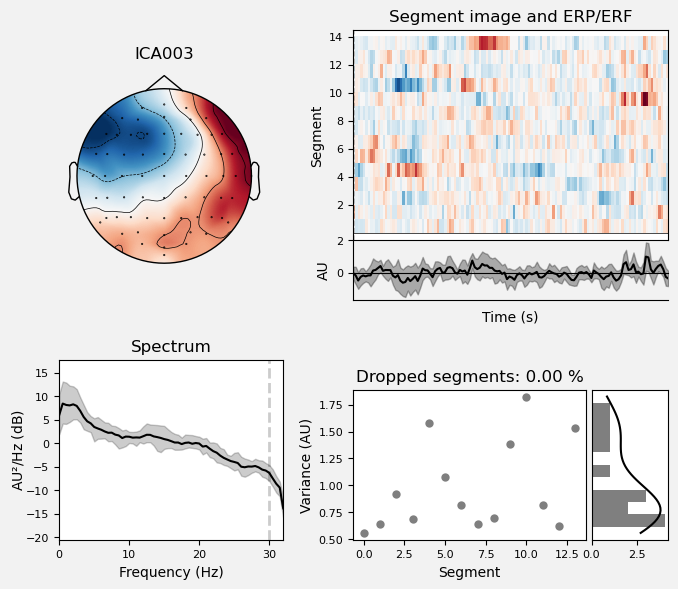

In [20]:
for ica_chan in [0, 1, 2, 3]:
    ica.plot_properties(
        raw_filt,
        picks = [ica_chan],
        #image_argsdict = {}, # https://mne.tools/stable/generated/mne.viz.plot_epochs_image.html#mne.viz.plot_epochs_image
    )
    plt.show()

Identify ICA source with blinks

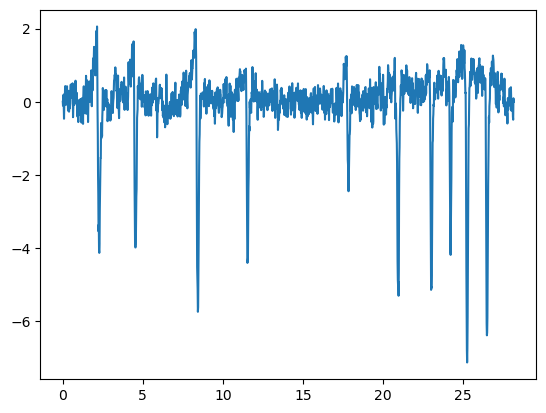

In [21]:
eog_src = ica.get_sources(raw_filt)[0]

plt.plot(eog_src[1], eog_src[0][0])
plt.show()

Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 640 samples (10.000 sec)

Now detecting blinks and generating corresponding events
Found 12 significant peaks
Number of EOG events detected: 12


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


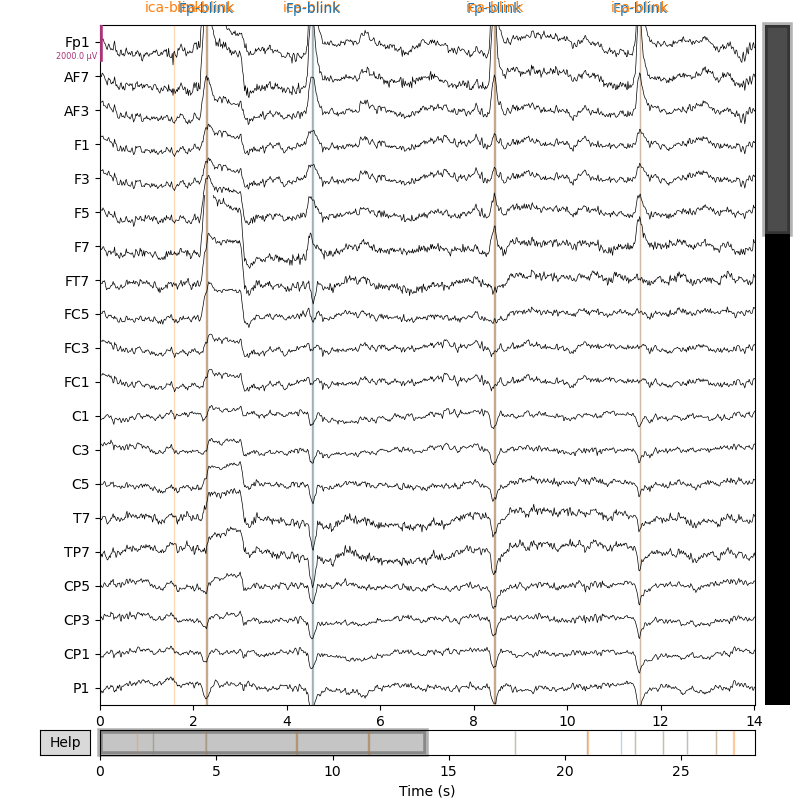

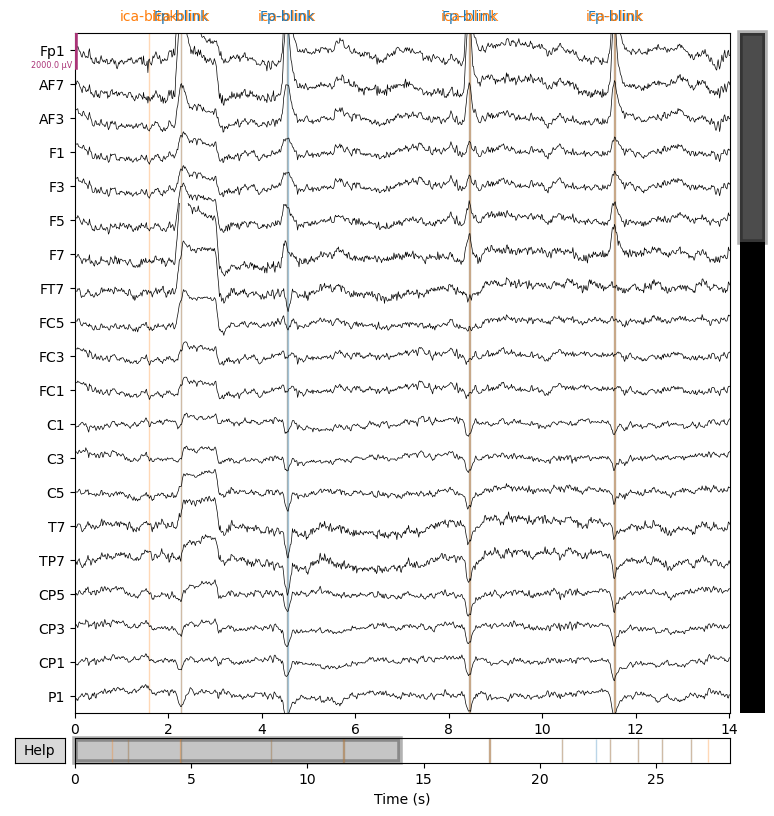

In [22]:
%matplotlib widget

ica_eog_event_id = 3

ica_eog_events = mne.preprocessing.ica_find_eog_events(
    raw_filt,
    eog_source = eog_src[0][0],
    event_id = ica_eog_event_id,
    #ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
)

ica_eog_annots = mne.annotations_from_events(
    ica_eog_events,
    sfreq = raw.info['sfreq'],
    event_desc = {ica_eog_event_id: "ica-blink"},
)
raw.set_annotations(eog_annots + ica_eog_annots)

#raw.add_events(eog_events)

scalings = {'eeg': 1e-3}
raw.plot(
    duration = 14,
    scalings = scalings
)


In [23]:
eog_events

array([[ 145,    0,    2],
       [ 291,    0,    2],
       [ 540,    0,    2],
       [ 739,    0,    2],
       [1141,    0,    2],
       [1340,    0,    2],
       [1434,    0,    2],
       [1473,    0,    2],
       [1550,    0,    2],
       [1616,    0,    2],
       [1695,    0,    2]])

In [24]:
ica_eog_events

array([[ 101,    0,    3],
       [ 145,    0,    3],
       [ 290,    0,    3],
       [ 540,    0,    3],
       [ 739,    0,    3],
       [1141,    0,    3],
       [1341,    0,    3],
       [1473,    0,    3],
       [1550,    0,    3],
       [1616,    0,    3],
       [1695,    0,    3],
       [1743,    0,    3]])

# Run ICA for all trials across selected subjects

To Do:

We don't need all this indexing. Just the trial# is sufficient to identify condition and song.

In [25]:
from collections import OrderedDict

def get_blink_events(raw_trials):
    eog_peaks = OrderedDict()

    for subjectID in raw_trials:
        eog_peaks[subjectID] = OrderedDict()

        for raw in raw_trials[subjectID]:
            
            trialIdx = int(raw.info['description'])
            # These are redundant given trialIdx
            #stimLabel = stimId_to_Song_map[stimIdxs[trialIdx]]
            #condLabel = condId_to_State_map[condIdxs[trialIdx]]

            # BPF
            raw_filt = raw.copy().filter( # ica-label needs 1-100Hz
                l_freq=1, 
                h_freq=30,
                verbose = 'ERROR',
            )

            # Reference to average
            raw_filt.set_eeg_reference(
                'average',
                verbose = 'ERROR',
                )

            # Run ICA
            ica = mne.preprocessing.ICA(
                n_components = 63,
                # method='infomax', # needed by ica-label, but takes longer to run than fastica (default)
                verbose = 'ERROR',
            )

            ica.fit(
                raw_filt,
                reject = None,
                reject_by_annotation=False,
                verbose = 'ERROR',
            )

            # ica.plot_sources(raw_filt)
            
            # find which ICs match the EOG pattern
            eog_indices, eog_scores = ica.find_bads_eog(
                raw_filt,
                # skip filtering again since we are already using 1-10Hz BPF
                l_freq = None, 
                h_freq = None, 
                ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
                verbose = 'ERROR',
            )
            
            # Assume top component is blinks (use the top eog scoring ICA component)
            eog_src = ica.get_sources(raw_filt)[eog_indices[0]]
            '''
            plt.title(f"Top IC for {raw_filt.info['description']}")
            plt.plot(eog_src[1], eog_src[0][0])
            plt.show()
            '''

            # Find EOG events frop top IC
            ica_eog_event_id = 3
            ica_eog_events = mne.preprocessing.ica_find_eog_events(
                raw_filt,
                eog_source = eog_src[0][0],
                event_id = ica_eog_event_id,
                #ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
            )

            eog_peaks[subjectID][trialIdx] = OrderedDict()
            eog_peaks[subjectID][trialIdx]['ica_eog_events'] = ica_eog_events[:, 0]
            eog_peaks[subjectID][trialIdx]['source'] = eog_src[0][0]
    
    return eog_peaks

(This step takes about 5 mins per subject!)

In [26]:
LOAD_SAVED_DATA = True

if LOAD_SAVED_DATA:
    eog_peaks = np.load(f'eog_peaks_{len(raw_trials)}subs.npy', allow_pickle=True)
    eog_peaks = eog_peaks.flat[0]
    
else: # This step takes 15 mins!
    eog_peaks = get_blink_events(raw_trials)
    
    np.save(
        file = f'eog_peaks_{len(eog_peaks)}subs',
        arr = eog_peaks,
    )
    

In [27]:
raw_trials.keys()

dict_keys([1, 3, 7, 11])

In [28]:
eog_peaks.keys()

odict_keys([1, 3, 7, 11])

Plot top IC (highest EOG score) for all subjects, conditions, songs, and trials

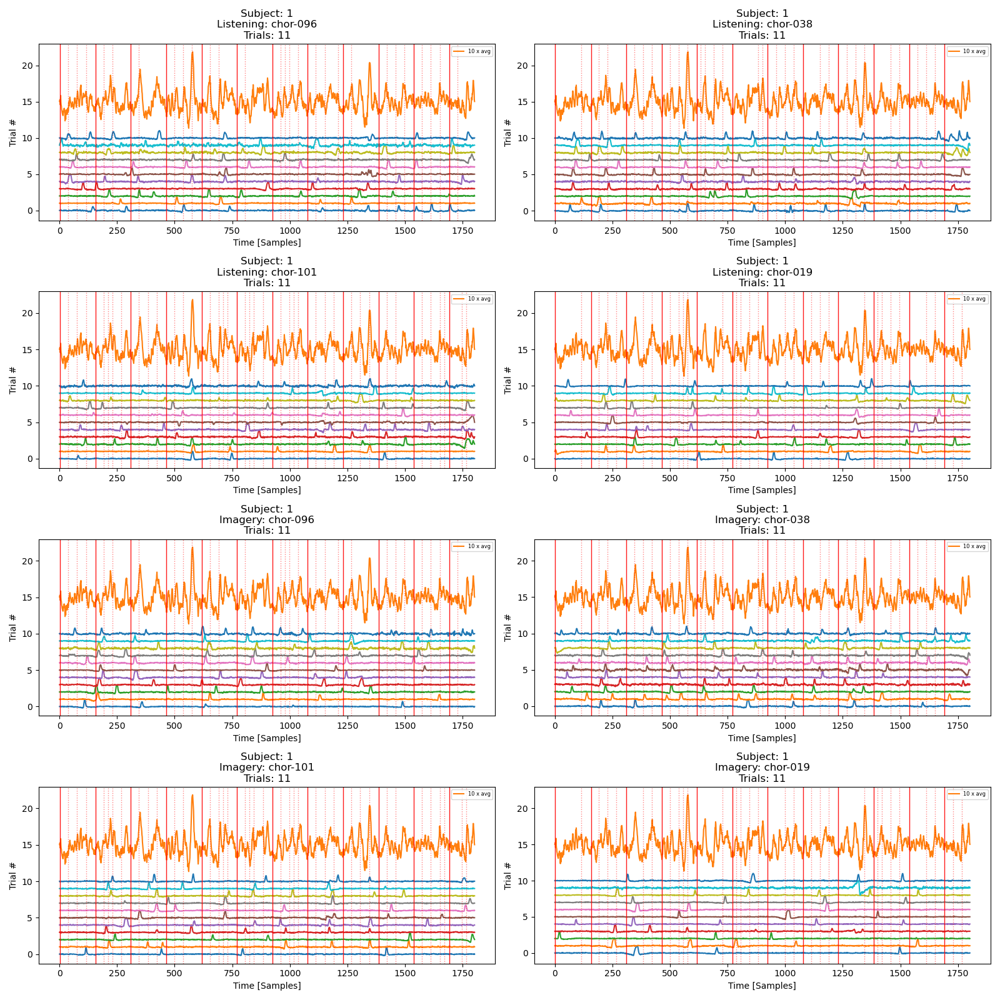

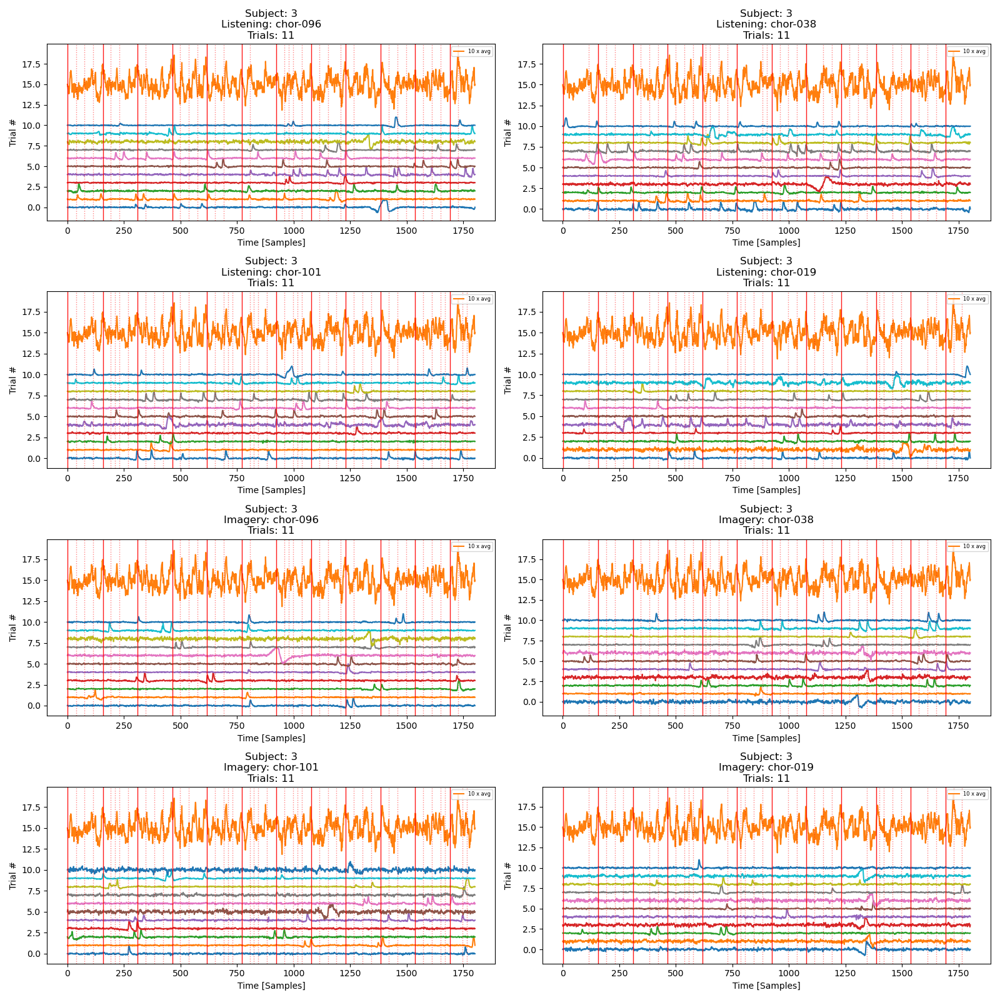

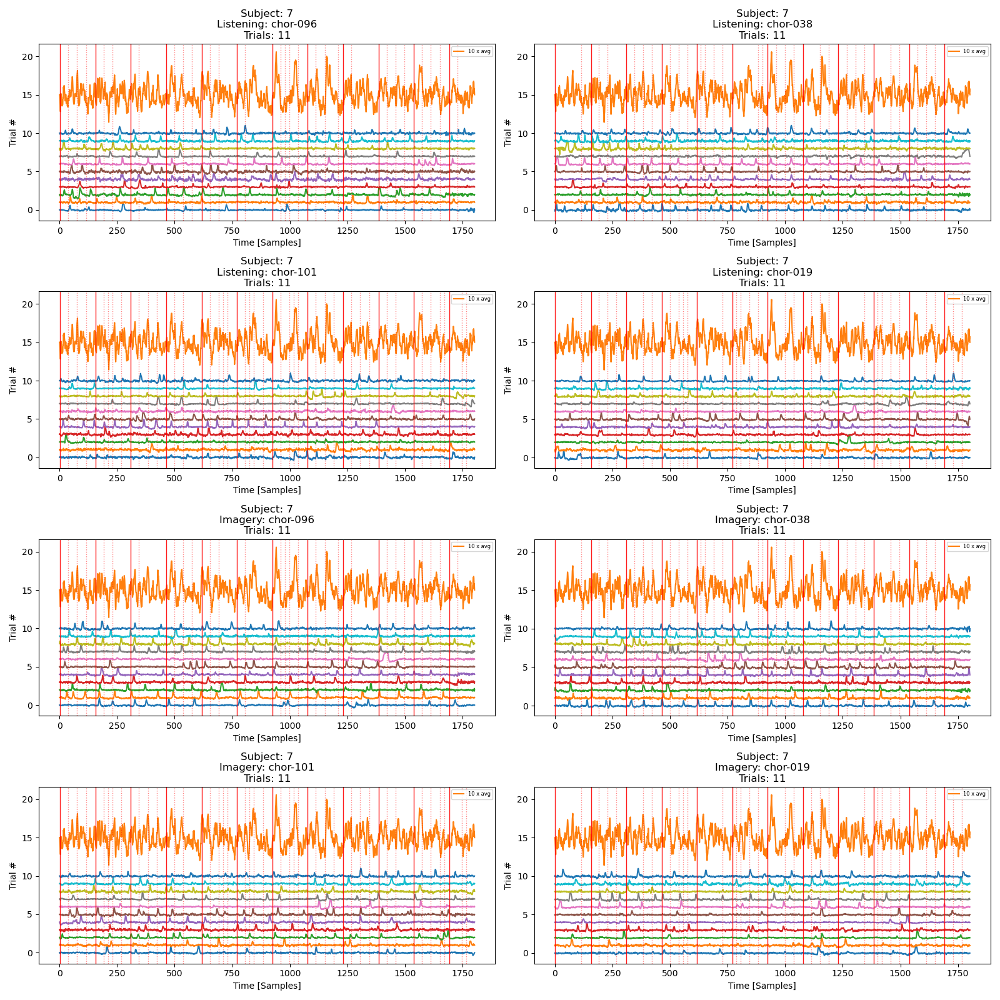

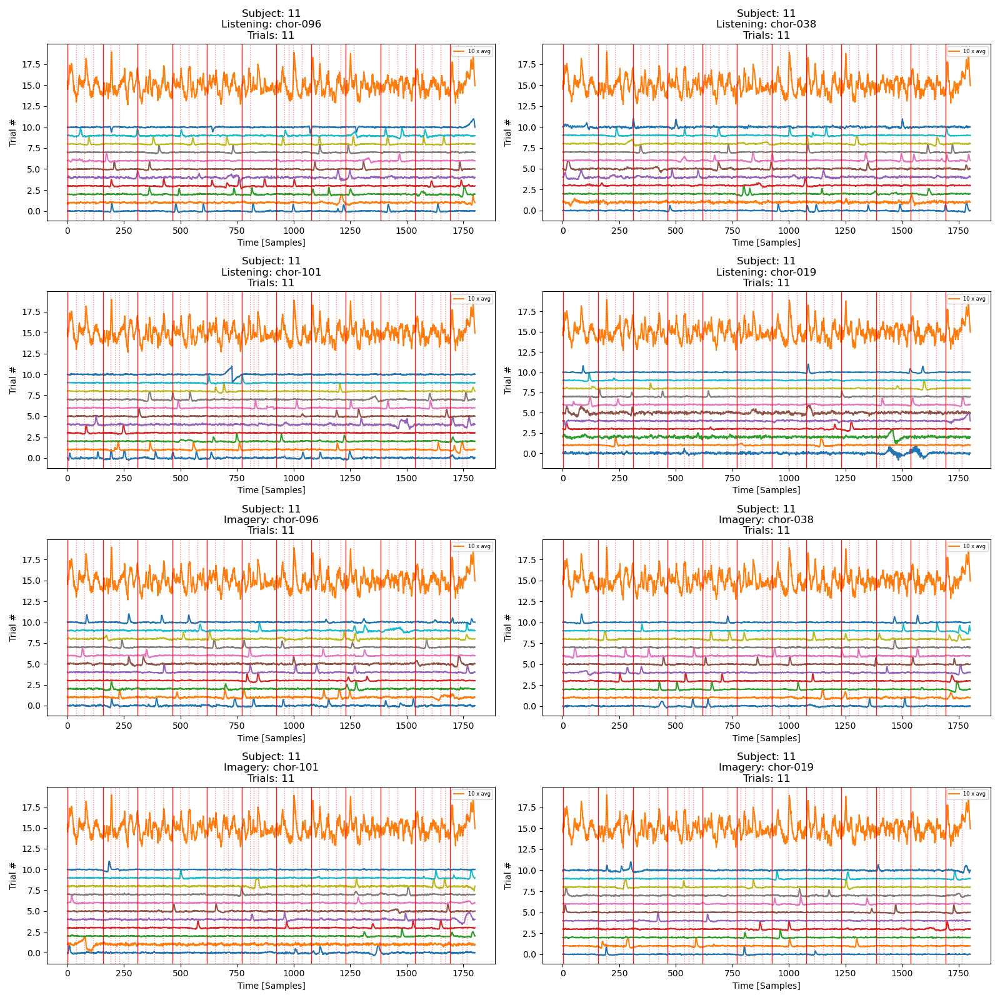

In [29]:
AVG_SCALE = 10
AVG_OFFSET = 15

for subjectID in eog_peaks:

    # Make a new figure per subject, song, and condition 
    plt.figure(figsize=(16, 16))

    t = np.arange(start=0, stop=1803, step=1, dtype='float64')

    # Container for collecting average across trials
    src_avg = [np.zeros_like(t)]*8
    N_avg = 11 #len(eog_peaks[subjectID])
    
    trialOffset = [0]*8

    # Plot eog_source traces for each subject, trial
    for trialIdx in eog_peaks[subjectID]:

        eog_source = eog_peaks[subjectID][trialIdx]['source']
        max_peak = np.max(eog_source)
        min_peak = np.min(eog_source)
        if np.abs(min_peak) > np.abs(max_peak):
            eog_source /= min_peak # normalize, flip polarity
        else:
            eog_source /= max_peak # normalize

        stimIdx = stimIdxs[trialIdx]
        condIdx = condIdxs[trialIdx]

        pltIdx = 4*(condIdx-1) + stimIdx

        # Plot Fp1 data for these trials
        plt.subplot(4, 2, pltIdx)

        # Plot and add an offset for each trial
        plt.plot(eog_source + trialOffset[pltIdx-1]) # chan0 is FP1

        # Average
        src_avg[pltIdx-1] += eog_source / N_avg

        trialOffset[pltIdx-1] += 1
            
    # Also plot notes/beats and add titles
    for stimIdx in [1, 2, 3, 4]: # ordering of stim doesn't matter for plotIdx
        stimLabel = stimId_to_Song_map[stimIdx]
        notes = t[stim[stimLabel]['notes']]
        beats = t[stim[stimLabel]['beats']>0]

        for condIdx in [1, 2]:
            condLabel = condId_to_State_map[condIdx]

            pltIdx = 4*(condIdx-1) + stimIdx

            # Plot Fp1 data for these trials
            plt.subplot(4, 2, pltIdx)

            # Plot the average
            plt.plot(AVG_SCALE * src_avg[pltIdx-1] + AVG_OFFSET, 
                     label=f'{AVG_SCALE} x avg')

            # draw beat/note onsets
            for note in notes:
                plt.axvline(x=note, c='r', linewidth=1, alpha=0.5, linestyle=':')
            for beat in beats:
                plt.axvline(x=beat, c='r', linewidth=1, alpha=0.9) #0 * t_bar[beats_bar], '*')

            title_str = '' #'='*50 + '\n'
            title_str += f'Subject: {subjectID}\n'
            title_str += f'{condLabel}: {stimLabel}\n'
            title_str += f'Trials: {N_avg}'
            plt.title(title_str)

            plt.xlabel('Time [Samples]')
            plt.ylabel('Trial #')
            plt.legend(loc='upper right', prop={'size': 6}) #, bbox_to_anchor=[1.5, 0.5])
            #print(title_str)

            pltIdx += 1

    plt.tight_layout()

In [30]:
len(raw_trials[1])

88

/var/folders/st/wjnxghxn7_b382gv3l4lxt0m0000gn/T/ipykernel_29620/1780699477.py:36: RuntimeWarning: divide by zero encountered in log10
  plt.semilogx(ω/two_pi, 20 * np.log10(abs(h)))


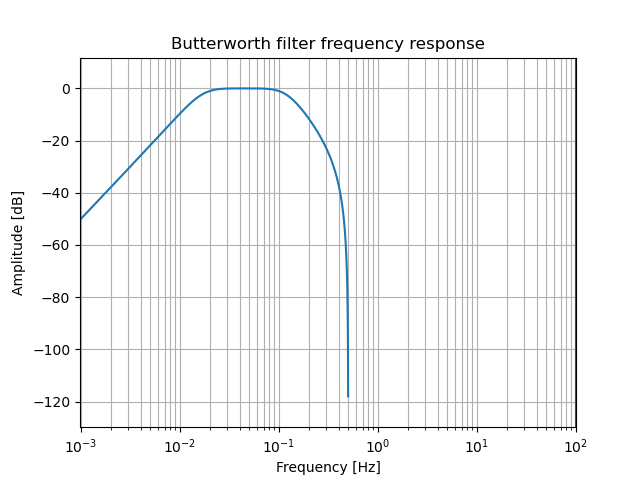

In [31]:
from scipy import signal

fs = 64
two_pi = 2*np.pi

lo_cutoff_Hz = 1
hi_cutoff_Hz = 8

sos = signal.butter(
    N = 2,
    Wn = [lo_cutoff_Hz, hi_cutoff_Hz],
    btype = 'bandpass',
    analog = False,
    output = 'sos',
    fs = fs,
)

'''
b, a = signal.butter(
    N = 2,
    Wn = [0.1, 30],
    btype = 'bandpass',
    analog = False,
    output = 'ba',
    fs = 64,
)
'''

# Freq response 
# code from https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html
#ω, h = signal.freqs(b, a)

plt.figure()

ω, h = signal.sosfreqz(sos)
plt.semilogx(ω/two_pi, 20 * np.log10(abs(h)))
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [Hz]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(100, color='green') # cutoff frequency
plt.show()

In [32]:
# Try different BPF settings to try and improve EOG event detection 

def ica_find_eog_events_custom(raw_trials, subjectID, trialIdx, source, l_freq, h_freq):
    
    #print(f'[{trialIdx}] from {raw_trials[subjectID]}')
    
    raw = raw_trials[subjectID][trialIdx-1]

    # Find EOG events frop top IC
    ica_eog_event_id = 3
    ica_eog_events = mne.preprocessing.ica_find_eog_events(
        raw,
        eog_source = source,
        event_id = ica_eog_event_id,
        l_freq = l_freq,
        h_freq = h_freq,
        verbose='ERROR',
        #ch_name = ['Fpz', 'Fp1', 'Fp2', 'AF7', 'AF3', 'Afz', 'AF4', 'AF8'],
    )

    return ica_eog_events

from scipy.signal import find_peaks

def find_peaks_from_ica_source(
    eog_source,
    fs = 64,
    height = 0.5,
    distance = 32,
    bpf = True,
    l_freq = 1,
    h_freq = 10,
    order = 2,
):
    # Normalize eog source
    max_peak = np.max(eog_source)
    min_peak = np.min(eog_source)
    if np.abs(min_peak) > np.abs(max_peak):
        eog_source /= min_peak # normalize, flip polarity
    else:
        eog_source /= max_peak # normalize

    if bpf:
        sos = signal.butter(
            N = order,
            Wn = [l_freq, h_freq],
            btype = 'bandpass',
            analog = False,
            output = 'sos',
            fs = fs,
        )
        eog_source = signal.sosfiltfilt(sos, eog_source)

    # Find peaks
    ica_eog_events, _ = find_peaks(
        eog_source,
        height = height, 
        distance = distance, # could miss double blinks 
    )

    return ica_eog_events

orig_trial_pos shape: (88,)
Subject1 stim order: [1 1 2 2 3 3 3 4 1 1 1 1 1 2 3 4 4 4 1 2 2 3 1 1 2 3 3 4 4 4 3 3 4 2 2 3 1
 1 1 1 2 2 2 3 2 2 3 3 4 2 2 3 4 4 4 1 3 4 4 1 2 2 3 3 3 4 1 2 2 3 4 2 3 3
 4 4 4 1 1 1 2 1 1 2 3 4 4 4]
Subject1 cond order: [1 1 1 1 1 1 1 1 2 2 2 1 1 1 1 1 1 1 2 2 2 2 1 1 1 1 1 1 1 1 2 2 2 1 1 1 2
 2 2 2 2 2 2 2 1 1 1 1 1 2 2 2 2 2 2 1 1 1 1 2 2 2 2 2 2 2 1 1 1 1 1 2 2 2
 2 2 2 1 1 1 1 2 2 2 2 2 2 2]
orig_trial_pos shape: (88,)
Subject3 stim order: [1 2 2 3 4 4 1 2 2 2 3 1 3 3 4 4 4 1 3 4 4 4 1 2 3 4 1 1 2 2 2 3 4 2 3 4 1
 1 2 2 3 3 4 4 1 1 1 2 3 4 1 2 3 3 4 1 1 2 2 3 4 4 1 3 4 4 2 2 2 2 3 4 1 1
 2 3 3 1 1 1 3 3 3 1 2 3 4 4]
Subject3 cond order: [1 1 1 1 1 1 2 2 2 2 2 1 1 1 1 1 1 2 2 2 2 2 1 1 1 1 2 2 2 2 2 2 2 1 1 1 2
 2 2 2 2 2 2 2 1 1 1 1 1 1 2 2 2 2 2 1 1 1 1 1 1 1 2 2 2 2 1 1 1 1 1 1 2 2
 2 2 2 1 1 1 1 1 1 2 2 2 2 2]
orig_trial_pos shape: (88,)
Subject7 stim order: [2 3 4 1 2 2 2 3 3 4 4 2 2 3 3 3 4 4 4 2 2 4 1 1 1 2 2 3 4 1 1 2 3 1 1 2 3
 3 4 4 2 4 4 4 1

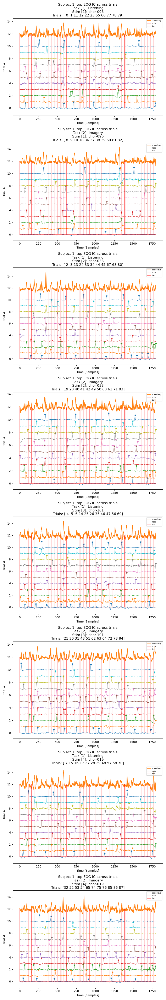

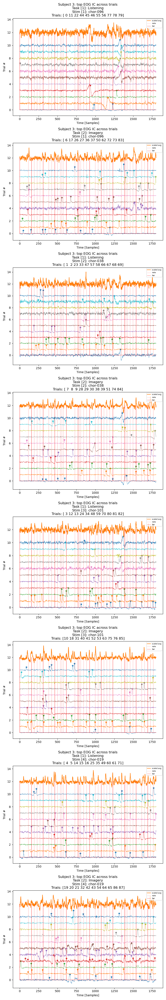

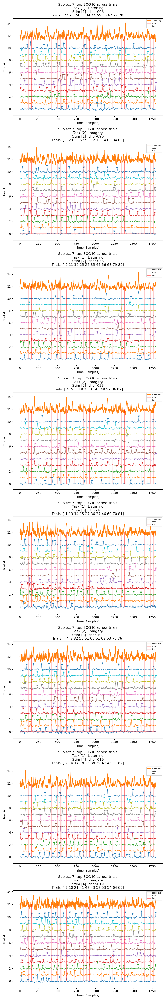

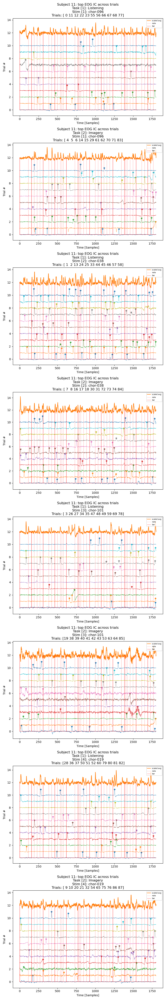

In [33]:
CUSTOM_BPF = False
USE_PEAK_FINDER = True
UPDATE_EOG_PEAKS = True

# Plot and add an offset for each trial
t = np.arange(start=0, stop=1803, step=1)

for subjectID in eog_peaks:
    
    plt.figure(figsize=(8, 48))
    pltIdx = 1


    # Path to data for selected subject
    sub1_mat = loadmat(dataDir+f"/dataCND/dataSub{subjectID}.mat", simplify_cells = True) 

    # Randomized trial order for current subject
    orig_trial_pos = sub1_mat['eeg']['origTrialPosition']
    print(f'orig_trial_pos shape: {orig_trial_pos.shape}')

    # Get current subject's song and condition ordering (since its randomized)
    thisSubStimOrder = stimIdxs[(orig_trial_pos-1)] # convert to being zero indexed
    thisSubCondOrder = condIdxs[(orig_trial_pos-1)]
    print(f'Subject{subjectID} stim order: {thisSubStimOrder}')
    print(f'Subject{subjectID} cond order: {thisSubCondOrder}')
    

    for stimIdx in [1, 2, 3, 4]: # top to bottom on the sheet music
        stimLabel = stimId_to_Song_map[stimIdx]

        for condIdx in [1, 2]:
            condLabel = condId_to_State_map[condIdx]

            # Find trials matching this song and condition
            trialsToEpoch = np.where(
                (thisSubStimOrder == stimIdx) & (thisSubCondOrder == condIdx)
            )[0]

            trials_to_plot = trialsToEpoch # idxs[condLabel][stimLabel]

            # Plot Fp1 data for these trials
            plt.subplot(8, 1, pltIdx)
            offset = 0
            N_avg = 11
            source_avg = np.zeros_like(t, dtype='float64')
            
            for trialIdx in trials_to_plot:
                source = eog_peaks[subjectID][trialIdx]['source']

                if CUSTOM_BPF == True:
                    ica_eog_events = ica_find_eog_events_custom(
                        raw_trials, 
                        subjectID, 
                        trialIdx, 
                        source,
                        l_freq = 1,
                        h_freq = 3,
                    )
                elif USE_PEAK_FINDER:
                    ica_eog_events = find_peaks_from_ica_source(
                        source,    
                        height = 0.25,
                        distance = 20, # assuming half_width = 10 below
                        l_freq = 1,
                        h_freq = 8,
                        order = 2,
                    )
                else:
                    ica_eog_events = eog_peaks[subjectID][trialIdx]['ica_eog_events']

                if UPDATE_EOG_PEAKS:
                    eog_peaks[subjectID][trialIdx]['ica_eog_events'] = ica_eog_events

                # print(t)

                # plt.plot(fp1_data_hp + offset -1)
                ic_trace, = plt.plot(
                    t,
                    source + offset,
                    linewidth = 0.5,
                )
                
                plt.plot(
                    t[ica_eog_events], 
                    source[ica_eog_events] + offset, 
                    '*',
                    color = ic_trace.get_color())

                offset += 1 # increment offset for next run

                # Average
                source_avg += source / N_avg

            # Plot the average
            # print(fp1_avg)
            offset = 12
            plt.plot(10 * source_avg + offset, label='scaled avg')

            # Plot the note onsets
            plt.plot(offset * note_onsets, 'r', 
                     label='note', 
                     alpha=0.2,
                     linewidth=1
                    ) # 1 = expectations

            # Plot metronome hits (could overlap with some notes)
            plt.plot(offset * cueExp, 
                     'r', 
                     label='bar', 
                     alpha=0.5,
                     linewidth=1
                    )

            condName = condId_to_State_map[condIdx]
            stimName = stimId_to_Song_map[stimIdx]

            title_str = '' #'='*50 + '\n'
            title_str += f'Subject {subjectID}: top EOG IC across trials\n'
            title_str += f'Task [{condIdx}]: {condName}\n'
            title_str += f'Stim [{stimIdx}]: {stimName}\n'
            title_str += f'Trials: {trials_to_plot}'
            plt.title(title_str)

            plt.xlabel('Time [Samples]')
            plt.ylabel('Trial #')
            plt.legend(loc='upper right', prop={'size': 6}) #, bbox_to_anchor=[1.5, 0.5])
            #print(title_str)

            pltIdx += 1

    plt.tight_layout()

In [34]:
def blink_atten(
        t, 
        peaks, 
        half_width
    ):
    peaks_sq = np.zeros_like(t)
    for peak in peaks:
        start_ndx = peak-half_width
        stop_ndx = peak+half_width
        if start_ndx < 0:
            start_ndx = 0
        if stop_ndx > len(t):
            stop_ndx = len(t)
        peaks_sq[start_ndx : stop_ndx] += 1
    return peaks_sq

/var/folders/st/wjnxghxn7_b382gv3l4lxt0m0000gn/T/ipykernel_29620/2103641729.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 4))


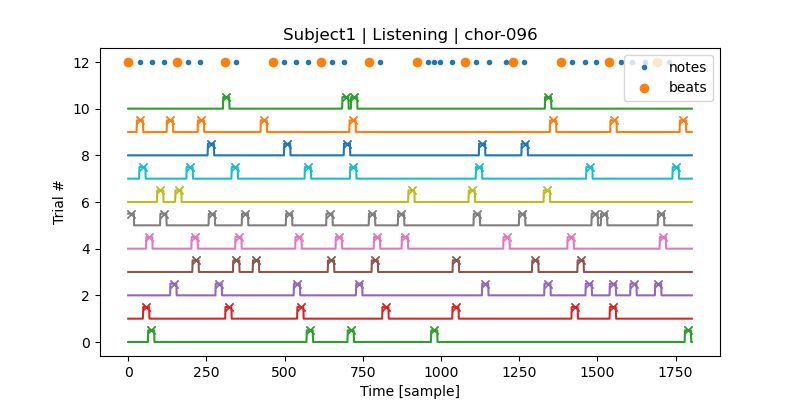

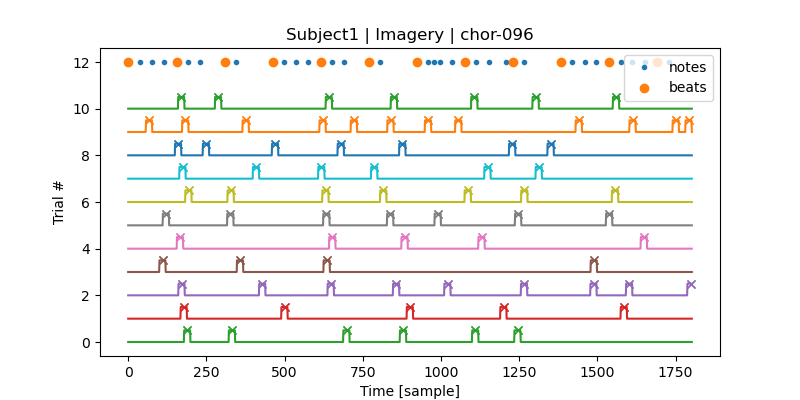

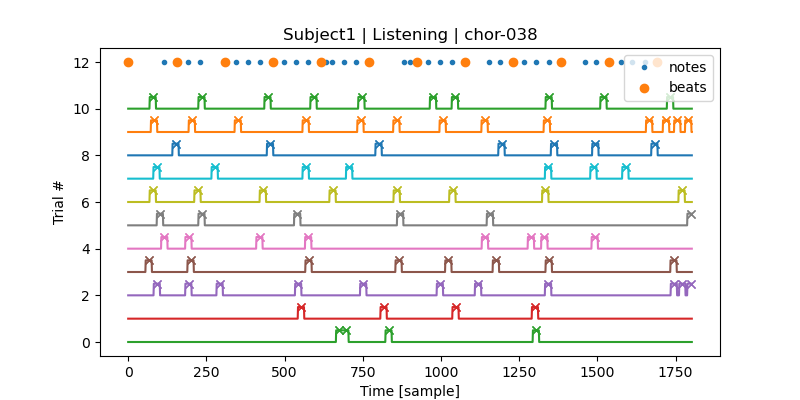

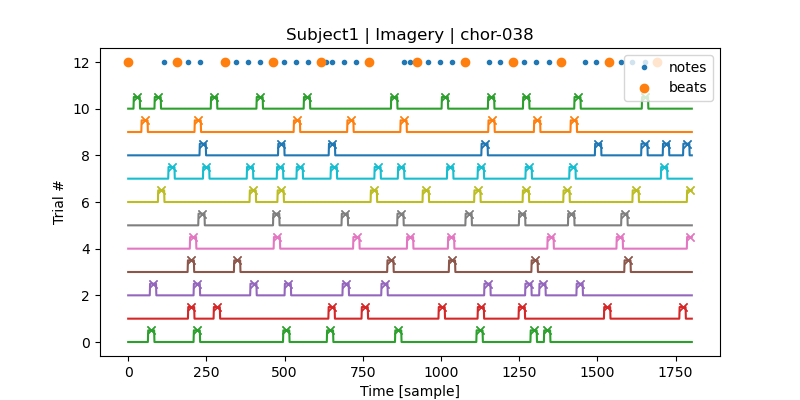

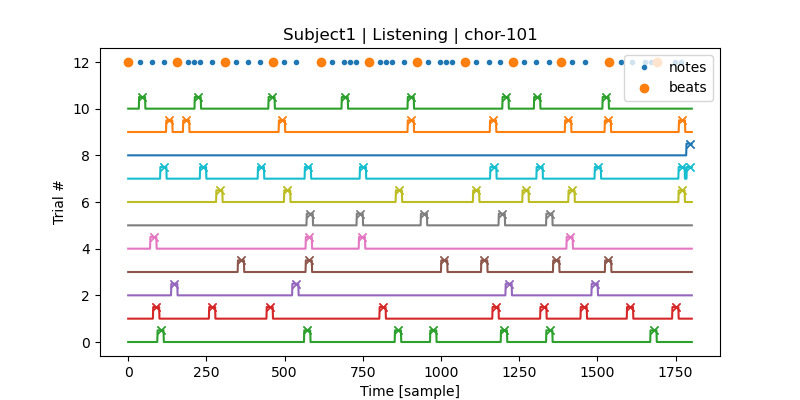

...

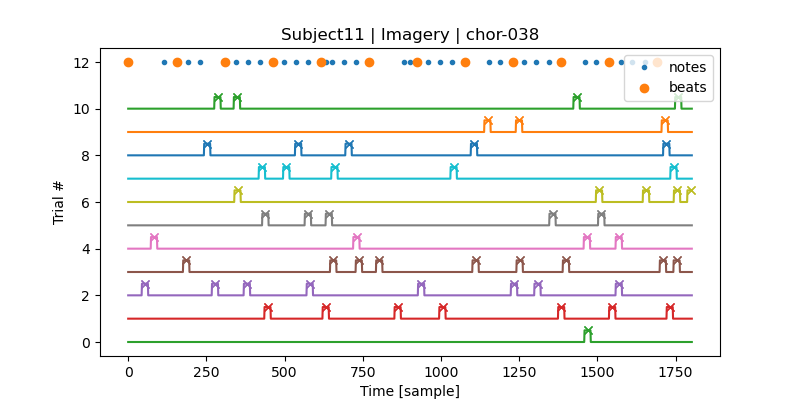

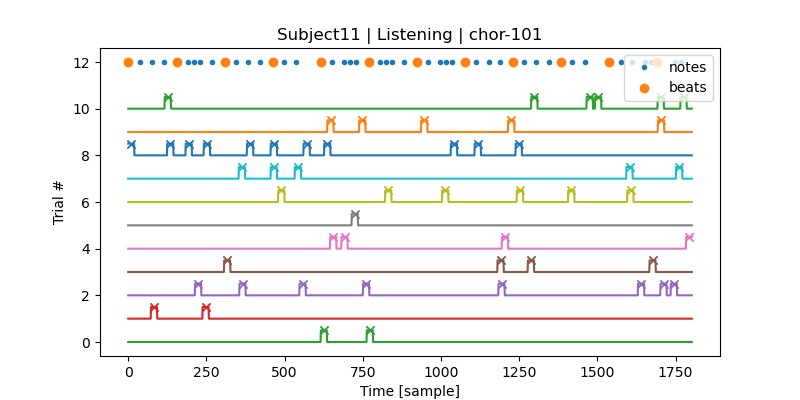

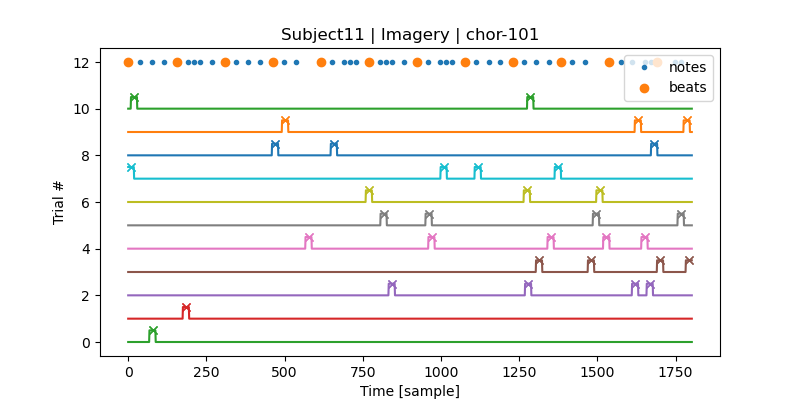

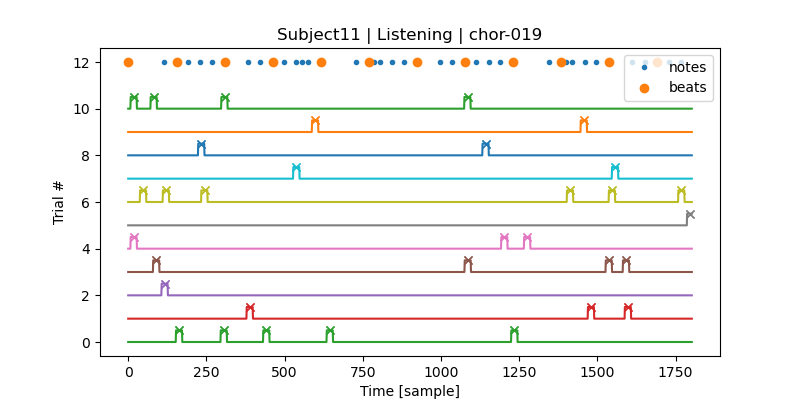

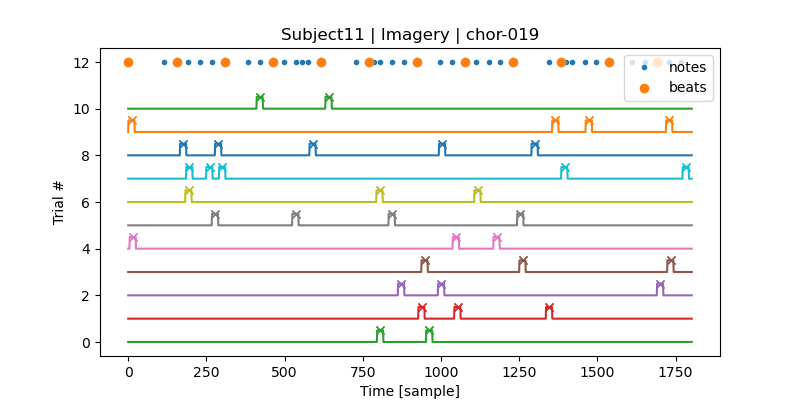

In [35]:
import numpy as np
np.random.seed(260)

NOTES_Y_OFFSET = 12

half_width = 10

t = np.arange(start=0, stop=len(cueExp), step=1)

peaks_sq_all = {}
for subjectID in eog_peaks:
    peaks_sq_all[subjectID] = {}
    
    for stimIdx in [1, 2, 3, 4]: # top to bottom on the sheet music
        stimLabel = stimId_to_Song_map[stimIdx]
        peaks_sq_all[subjectID][stimLabel] = {}
        
        notes = t[stim[stimLabel]['notes']]
        beats = t[stim[stimLabel]['beats']>0]

        for condIdx in [1, 2]:
            condLabel = condId_to_State_map[condIdx]
            peaks_sq_all[subjectID][stimLabel][condLabel] = {}

            trials_to_plot = idxs[condLabel][stimLabel]
                
            plt.figure(figsize=(8, 4))

            plt.plot(t[notes], 0*t[notes] + NOTES_Y_OFFSET, '.', label='notes')
            plt.plot(t[beats], 0*t[beats] + NOTES_Y_OFFSET, 'o', label='beats')

            trialCnt = 0
            for trialIdx in trials_to_plot:
                peaks = eog_peaks[subjectID][trialIdx]['ica_eog_events']
                peaks_sq = blink_atten(t, peaks, half_width)
                
                peaks_sq_all[subjectID][stimLabel][condLabel][trialIdx] = peaks_sq

                #plt.plot(t, peaks_sq_rot + trialCnt)
                line, = plt.plot(t, peaks_sq/2 + trialCnt)
                plt.plot(t[peaks], 0*t[peaks] + trialCnt + 0.5, 'x', c=line.get_color())
                plt.plot(t[peaks], 0*t[peaks] + trialCnt + 0.5, 'x', c=line.get_color())

                trialCnt += 1

            plt.xlabel('Time [sample]')
            plt.ylabel('Trial #')
            plt.legend(loc='upper right')
            title_str = f'Subject{subjectID} | {condLabel} | {stimLabel}'
            plt.title(title_str)

## Read in images of the score

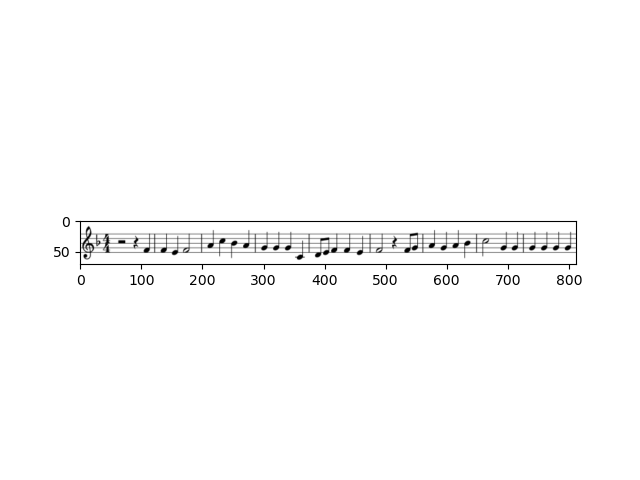

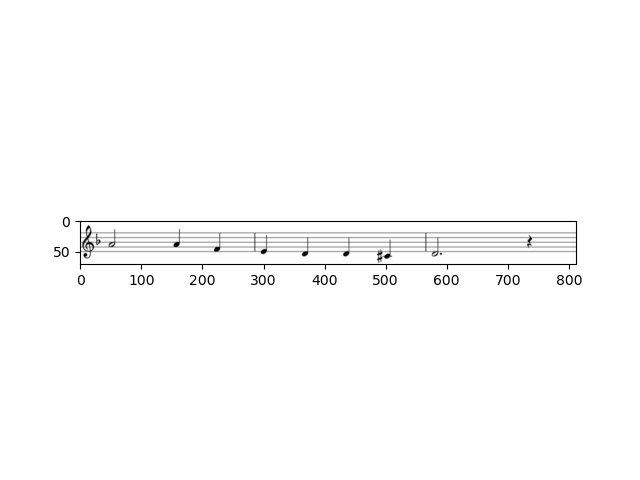

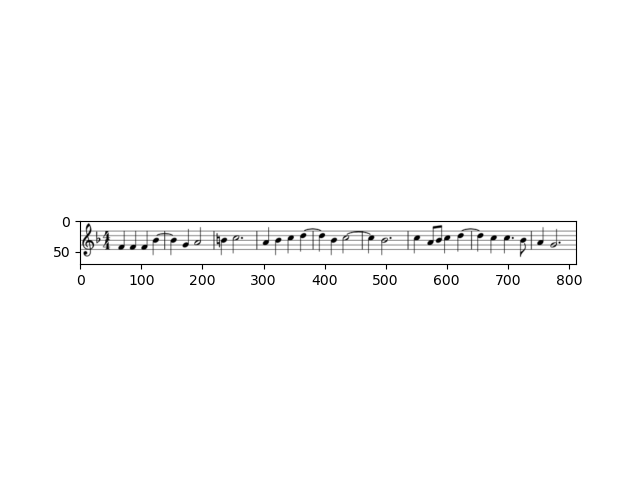

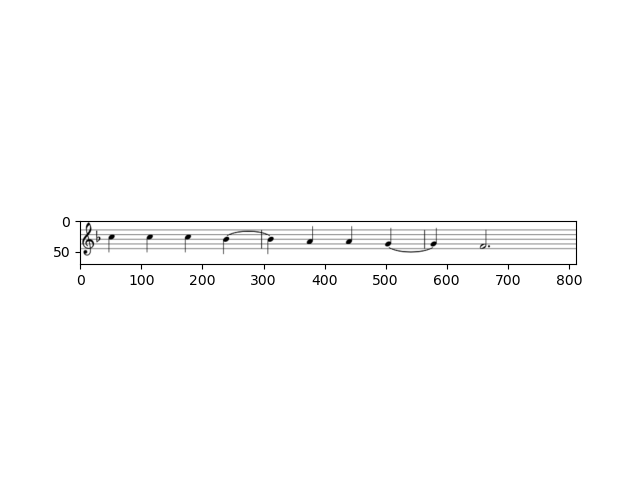

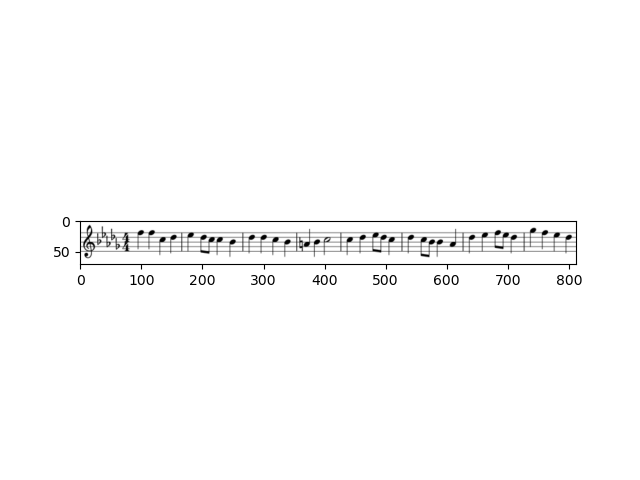

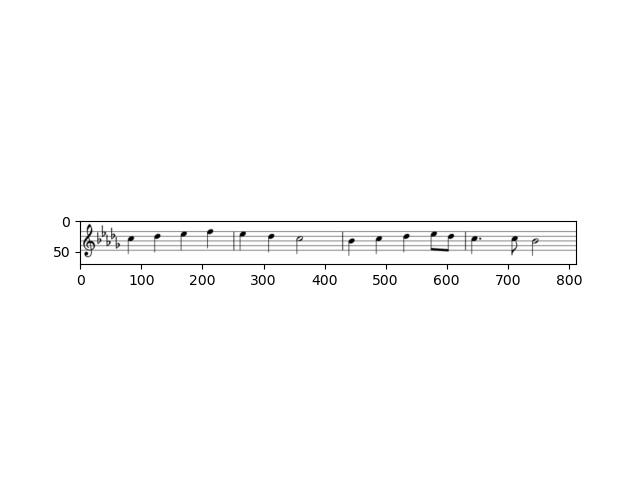

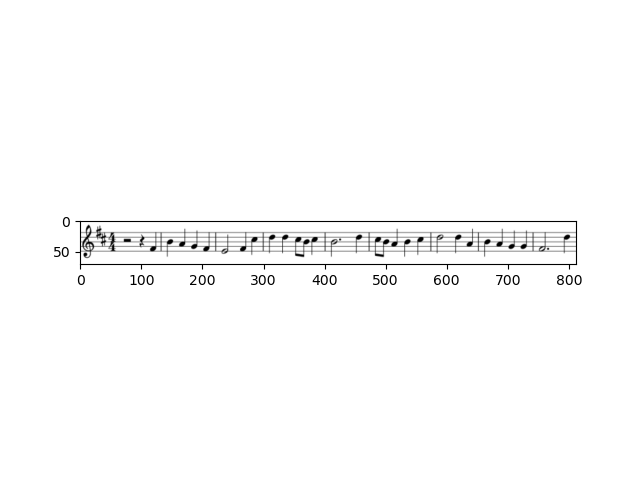

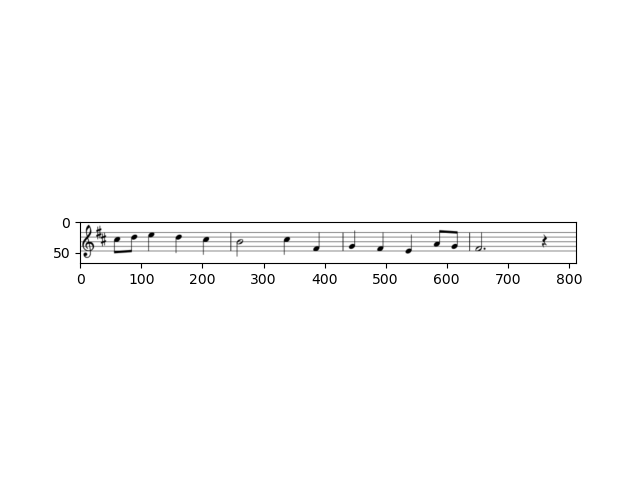

In [82]:
import matplotlib.image as mpimg
import matplotlib as mpl 

# from stackexchange
imgs = {}

start_px = 50
for bar in range(8):
    img = mpimg.imread('data/Score.png')
    
    stop_px = start_px + 70
    imgs[bar] = img[start_px:stop_px, 10:-15].copy()
    
    # offset to the next bar
    start_px += 100
    if bar%2 == 1:
        start_px += 100
        
%matplotlib widget 

for bar in range(8):
    plt.figure()
    plt.imshow(imgs[bar])
    plt.show()

In [39]:
condId_to_State_map

{1: 'Listening', 2: 'Imagery'}

In [114]:
condLabels = ['Imagery'] #['Listening'] # consider only listening

allTrialsForNullDistro = {} # by subject

for subjectID in eog_peaks:
    allTrialsForNullDistro[subjectID] = [] # this will get blink info for trials now numbered 0-10

    for trialIdx in eog_peaks[subjectID]:
        stimIdx = stimIdxs[trialIdx]
        condIdx = condIdxs[trialIdx]
        stimLabel = stimId_to_Song_map[stimIdx]
        condLabel = condId_to_State_map[condIdx]

        if condLabel in condLabels: # based on what data we want to use
            val_peaks_sq = peaks_sq_all[subjectID][stimLabel][condLabel][trialIdx]
            allTrialsForNullDistro[subjectID].append(val_peaks_sq)

print(len(allTrialsForNullDistro)) # 3 subjects
print(len(allTrialsForNullDistro[subjectID])) # 11 trials * 4 songs

4
44


In [109]:
stimLabel_to_id_map.keys()

dict_keys(['chor-038', 'chor-096', 'chor-101', 'chor-019'])

/var/folders/st/wjnxghxn7_b382gv3l4lxt0m0000gn/T/ipykernel_29620/834315652.py:37: DeprecationWarning: This function is deprecated. Please call randint(0, 43 + 1) instead
  randTrialIdxs = np.random.random_integers(


(10000, 1803)
(10000, 1803)
(10000, 1803)
(10000, 1803)


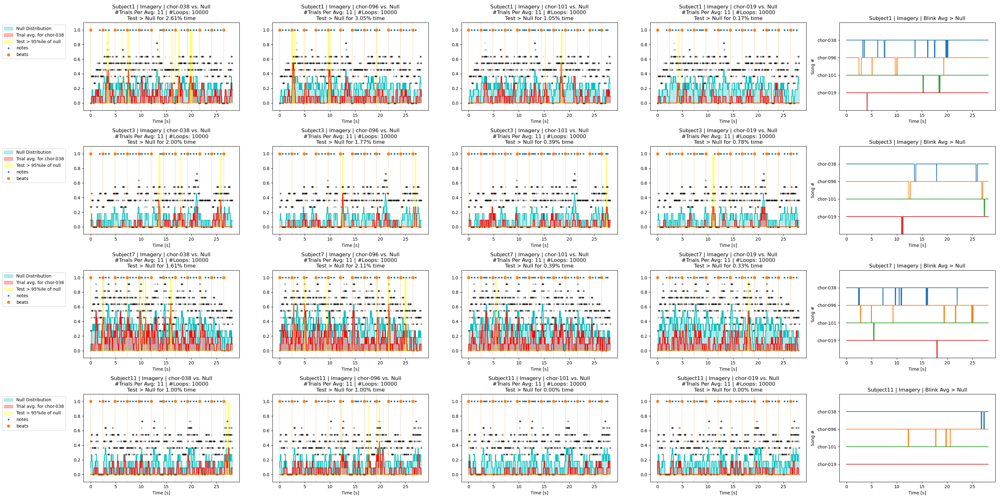

In [115]:
NUM_LOOPS = 10000
NUM_TRIALS = 11
TEST_STIM_LABELS = ['chor-038', 'chor-096', 'chor-101', 'chor-019']
NOTES_Y_OFFSET = 1

PLOT_POINT_CLOUD = False # this takes a lot of memory => slow down

LOAD_DISTRO = not True
SAVE_DISTRO = not LOAD_DISTRO 

fs = 64

baseline = {} # this will be the null distro
test_trial_avg = {}
peaks_sq_baseline_distro = {}

t = np.arange(start=0, stop=len(cueExp), step=1)

plt.figure(figsize = (32, 16))
pltIdx = 0

rowIdx = 1
for subjectID in allTrialsForNullDistro:
    if LOAD_DISTRO:
        peaks_sq_baseline_distro_samples = np.load(
            f"peaks_sq_baseline_distro_samples_sub{subjectID}_{','.join(condLabels)}_{NUM_LOOPS}.npy"
        )
        print(peaks_sq_baseline_distro_samples.shape)

    else:
        peaks_sq_baseline_distro[subjectID] = []

        # Draw NUM_TRIALS from all trials, and loop NUM_LOOPS times
        for n in range(NUM_LOOPS):
            peaks_sq_baseline = np.zeros_like(t, dtype=np.float64)
            
            randTrialIdxs = np.random.random_integers(
                low=0, 
                high=len(allTrialsForNullDistro[subjectID]) -1, 
                size=NUM_TRIALS,
            )

            for randn in randTrialIdxs: # decide which of 44 trials to draw
                #print(randn)
                peaks_sq_baseline += allTrialsForNullDistro[subjectID][randn]

            peaks_sq_baseline /= NUM_TRIALS # this gives us the average of 11 randomly selected trials
            peaks_sq_baseline_distro[subjectID].append(peaks_sq_baseline)

        #peaks_sq_baseline_distro_samples = np.empty_like(t) # this adds an extra row?
        i = 0
        for samples in peaks_sq_baseline_distro[subjectID]:
            if i == 0:
                peaks_sq_baseline_distro_samples = samples
            else:
                peaks_sq_baseline_distro_samples = np.vstack(
                    (peaks_sq_baseline_distro_samples, samples)
                )
            i+=1
        print(peaks_sq_baseline_distro_samples.shape)

        # sort the samples for every time stamp to get the 95% interval
        peaks_sq_baseline_distro_samples.sort(axis=0)

        # Save to memory!
        if SAVE_DISTRO:
            np.save(
                file=f"peaks_sq_baseline_distro_samples_sub{subjectID}_{','.join(condLabels)}_{NUM_LOOPS}",
                arr=peaks_sq_baseline_distro_samples,
            )

    test_trial_avg[subjectID] = {}
    for stimLabel in TEST_STIM_LABELS:
        pltIdx += 1
        ax = plt.subplot(len(allTrialsForNullDistro), 4+1, pltIdx)

        # Plot null distro point cloud
        if PLOT_POINT_CLOUD:
            #for samples in peaks_sq_baseline_distro[subjectID]:
            for row in range(peaks_sq_baseline_distro_samples.shape[0]):
                line, = ax.plot(
                    t/fs, 
                    peaks_sq_baseline_distro_samples[row], 
                    '.', 
                    #label='validation blinks', 
                    c='k',
                    alpha=0.1,
                    markersize=.1,
                    label = 'Max[null]'
                )
        else:
            max_line, = ax.plot(
                t/fs, 
                peaks_sq_baseline_distro_samples[-1, :], 
                '.', 
                #label='validation blinks', 
                c='k',
                alpha=0.1,
                #markersize=.1,
            )


        # Plot null distro CI intervals
        null_distro_95 = peaks_sq_baseline_distro_samples[int(.95*NUM_LOOPS), :]

        null_line, = ax.plot(
            t/fs, 
            null_distro_95, 
            #marker = '_',
            #ls = '', 
            #label='validation blinks', 
            c='c',
            #alpha=0.1,
        )

        ax.fill_between(
            t/fs, 
            peaks_sq_baseline_distro_samples[int(.95*NUM_LOOPS), :], 
            0, 
            color=null_line.get_color(), 
            alpha=.3,
            label = 'Null Distribution'
        )

        test_trial_avg[subjectID][stimLabel] = np.zeros_like(t, dtype=np.float64)

        notes = t[stim[stimLabel]['notes']]
        beats = t[stim[stimLabel]['beats']>0]
        
        for condLabel in condLabels:

            for trialIdx in peaks_sq_all[subjectID][stimLabel][condLabel]:
                val_peaks_sq = peaks_sq_all[subjectID][stimLabel][condLabel][trialIdx]
                test_trial_avg[subjectID][stimLabel] += val_peaks_sq
                
            test_trial_avg[subjectID][stimLabel] /= len(peaks_sq_all[subjectID][stimLabel][condLabel])

            test_distro = test_trial_avg[subjectID][stimLabel]

            avg_line, = ax.plot(
                t/fs, 
                test_distro, 
                #'.', 
                #label=f'Trial avg. for {stimLabel}', 
                c='r',
                #alpha=0.1,
            )

            ax.fill_between(
                t/fs, 
                test_distro, 
                0, 
                color=avg_line.get_color(), 
                alpha=.3,
                label=f'Trial avg. for {stimLabel}', 
            )

            significant_samples = (test_distro - null_distro_95) > 0

            sig_line, = ax.plot(
                t/fs,
                significant_samples,
                color = 'yellow',
                alpha = 0.3,
            )
            ax.fill_between(
                t/fs, 
                significant_samples, 
                0, 
                color=sig_line.get_color(), 
                label = 'Test > 95%ile of null',
                alpha=.3,
            )

            score = 100 * np.sum(significant_samples) / len(significant_samples)

        ax.plot(t[notes]/fs, 0*t[notes] + NOTES_Y_OFFSET, '.', label='notes')
        beat_dots, = ax.plot(t[beats]/fs, 0*t[beats] + NOTES_Y_OFFSET, 'o', label='beats')
        for beat in beats:
            ax.axvline(
                x=t[beat]/fs, 
                ls='-', # solid line
                alpha=0.2, 
                c=beat_dots.get_color()
            )

        #ax_base = ax.twinx()
        #ax_base.plot(t/fs, peaks_sq_baseline, label='baseline') #, c=line.get_color())
        
        title_str = f'Subject{subjectID} | {condLabel} | {stimLabel} vs. Null'
        title_str+= f'\n#Trials Per Avg: {NUM_TRIALS} | #Loops: {NUM_LOOPS}'
        title_str+= '\nTest > Null for {:.2f}% time'.format(score)
        ax.set_title(title_str)

        ax.set_xlabel('Time [s]')
        ax.set_ylim([-.1, 1.1])

        if (pltIdx % 5) == 1: # first column
            ax.legend(loc='upper right', bbox_to_anchor=[-0.1, 1])

        # Plot the significance curves for all songs in the last column
        axLastCol = plt.subplot(
            len(allTrialsForNullDistro), # nrows = no. of subjects
            4+1, # cols = no. of songs + one "bar codes" plot
            5*rowIdx, # select the last column of this row
        )
        sig_line, = axLastCol.plot(
            t/fs,
            significant_samples + int(stimLabel_to_sheet_order_map[stimLabel]),
            #color = 'yellow',
            label = stimLabel,
            #alpha = 0.3,
        )

        if 0: # overlay score images
            bar = 2 * (stimLabel_to_sheet_order_map[stimLabel] -1)
            # https://stackoverflow.com/questions/61169982/set-location-of-image-in-matplotlib
            image_artist = axLastCol.imshow(imgs[bar])

            if bar == 4: # 8 measures
                SCALE = 1803/fs #* 8/12.
            else: # 9 measures
                SCALE = 1803/fs #* 9/12.

            SCALE /= imgs[bar].shape[0]
            image_artist.set_extent(np.array(image_artist.get_extent())/SCALE)
            transform = mpl.transforms.Affine2D().translate(0, stimLabel_to_sheet_order_map[stimLabel])
            image_artist.set_transform(transform + axLastCol.transData)

        #ax_base.legend(loc='upper right', bbox_to_anchor=[1.3, 1])

    axLastCol.set_ylim([5, 0]) # flip axis to go top to bottom in song order of sheet music
    axLastCol.set_yticks(ticks=[1, 2, 3, 4], labels=['chor-038', 'chor-096', 'chor-101', 'chor-019'])
    #axLastCol.legend(loc='upper right')
    axLastCol.set_ylabel('Song #')
    axLastCol.set_xlabel('Time [s]')
    axLastCol.set_title(f'Subject{subjectID} | {condLabel} | Blink Avg > Null')

    pltIdx += 1 # since we already plotted the last column (bar codes)
    rowIdx += 1

plt.tight_layout()
        
plt.savefig(f'subs{len(allTrialsForNullDistro)}_{condLabel}_nullLoops{NUM_LOOPS}.png',
            format='png',
            dpi = 200,
            )

plt.show()



# Odd and Even Splits

In [85]:
idxs

{'Listening': {'chor-096': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
  'chor-038': array([11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21]),
  'chor-101': array([22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]),
  'chor-019': array([33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43])},
 'Imagery': {'chor-096': array([44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54]),
  'chor-038': array([55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65]),
  'chor-101': array([66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76]),
  'chor-019': array([77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87])}}

(10000, 1803)
(10000, 1803)
(10000, 1803)
(10000, 1803)


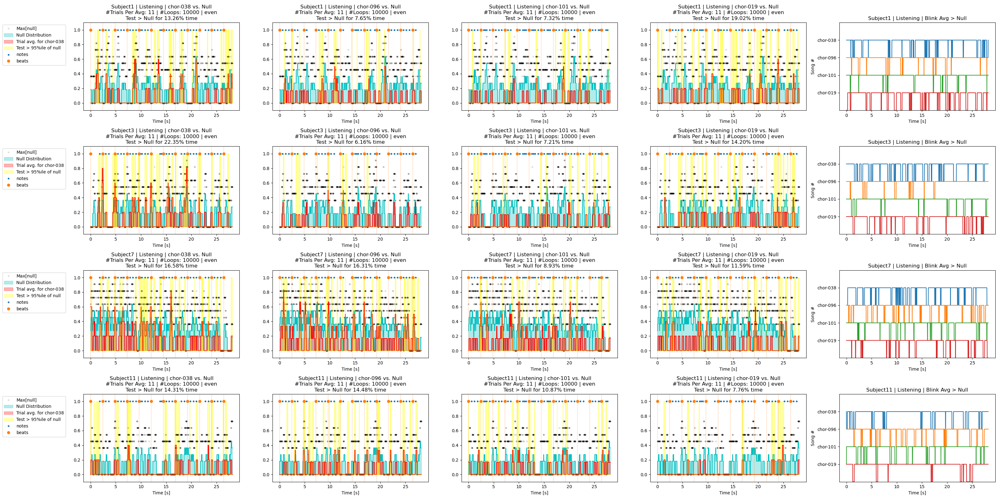

In [113]:
NUM_LOOPS = 10000 #10000
NUM_TRIALS = 11
TEST_STIM_LABELS = ['chor-038', 'chor-096', 'chor-101', 'chor-019']
NOTES_Y_OFFSET = 1

PLOT_POINT_CLOUD = False # this takes a lot of memory => slow down

LOAD_DISTRO = not True
SAVE_DISTRO = not LOAD_DISTRO 

fs = 64

cond_trials = range(len(allTrialsForNullDistro[subjectID])) # this should be handled per subject if trials are dropped
split_trials_odd = [i for i in cond_trials if i%2==1]
split_trials_even = [i for i in cond_trials if i%2==0]

baseline = {} # this will be the null distro
test_trial_avg = {}
peaks_sq_baseline_distro = {}

t = np.arange(start=0, stop=len(cueExp), step=1)

plt.figure(figsize = (32, 16))

for split in ['even']: #, 'odd']:
    if split == 'odd':
        split_trials = split_trials_odd
    else:
        split_trials = split_trials_even
    
    pltIdx = 0
    rowIdx = 1

    for subjectID in allTrialsForNullDistro:
        
        if LOAD_DISTRO:
            peaks_sq_baseline_distro_samples = np.load(
                f"peaks_sq_baseline_distro_samples_sub{subjectID}_{','.join(condLabels)}_{NUM_LOOPS}_{split}.npy"
            )
            print(peaks_sq_baseline_distro_samples.shape)

        else:
            peaks_sq_baseline_distro[subjectID] = []

            # Draw NUM_TRIALS from all trials, and loop NUM_LOOPS times
            for n in range(NUM_LOOPS):
                peaks_sq_baseline = np.zeros_like(t, dtype=np.float64)
                
                randTrialIdxs = np.random.choice(
                    split_trials,
                    size=NUM_TRIALS,
                )
                #print(randTrialIdxs)

                for randn in randTrialIdxs: # decide which of 44 trials to draw
                    #print(randn)
                    peaks_sq_baseline += allTrialsForNullDistro[subjectID][randn]

                peaks_sq_baseline /= NUM_TRIALS # this gives us the average of 11 randomly selected trials
                peaks_sq_baseline_distro[subjectID].append(peaks_sq_baseline)

            #peaks_sq_baseline_distro_samples = np.empty_like(t) # this adds an extra row?
            i = 0
            for samples in peaks_sq_baseline_distro[subjectID]:
                if i == 0:
                    peaks_sq_baseline_distro_samples = samples
                else:
                    peaks_sq_baseline_distro_samples = np.vstack(
                        (peaks_sq_baseline_distro_samples, samples)
                    )
                i+=1
            print(peaks_sq_baseline_distro_samples.shape)

            # sort the samples for every time stamp to get the 95% interval
            peaks_sq_baseline_distro_samples.sort(axis=0)

            # Save to memory!
            if SAVE_DISTRO:
                np.save(
                    file=f"peaks_sq_baseline_distro_samples_sub{subjectID}_{','.join(condLabels)}_{NUM_LOOPS}_{split}",
                    arr=peaks_sq_baseline_distro_samples,
                )

        test_trial_avg[subjectID] = {}
        for stimLabel in TEST_STIM_LABELS:
            pltIdx += 1
            ax = plt.subplot(len(allTrialsForNullDistro), 4+1, pltIdx)

            # Plot null distro point cloud
            if PLOT_POINT_CLOUD:
                #for samples in peaks_sq_baseline_distro[subjectID]:
                for row in range(peaks_sq_baseline_distro_samples.shape[0]):
                    line, = ax.plot(
                        t/fs, 
                        peaks_sq_baseline_distro_samples[row], 
                        '.', 
                        #label='validation blinks', 
                        c='k',
                        alpha=0.1,
                        markersize=.1,
                    )
            else:
                max_line, = ax.plot(
                    t/fs, 
                    peaks_sq_baseline_distro_samples[-1, :], 
                    '.', 
                    #label='validation blinks', 
                    c='k',
                    alpha=0.1,
                    #markersize=.1,
                    label = 'Max[null]'
                )

            # Plot null distro CI intervals
            null_distro_95 = peaks_sq_baseline_distro_samples[int(.95*NUM_LOOPS), :]

            null_line, = ax.plot(
                t/fs, 
                null_distro_95, 
                #marker = '_',
                #ls = '', 
                #label='validation blinks', 
                c='c',
                #alpha=0.1,
            )

            ax.fill_between(
                t/fs, 
                peaks_sq_baseline_distro_samples[int(.95*NUM_LOOPS), :], 
                0, 
                color=null_line.get_color(), 
                alpha=.3,
                label = 'Null Distribution'
            )

            test_trial_avg[subjectID][stimLabel] = np.zeros_like(t, dtype=np.float64)

            notes = t[stim[stimLabel]['notes']]
            beats = t[stim[stimLabel]['beats']>0]
            
            for condLabel in condLabels:
                Navg = 0
                for trialIdx in peaks_sq_all[subjectID][stimLabel][condLabel]:
                    if trialIdx in split_trials:
                        Navg += 1
                        val_peaks_sq = peaks_sq_all[subjectID][stimLabel][condLabel][trialIdx]
                        test_trial_avg[subjectID][stimLabel] += val_peaks_sq
                    
                test_trial_avg[subjectID][stimLabel] /= Navg #len(peaks_sq_all[subjectID][stimLabel][condLabel])

                test_distro = test_trial_avg[subjectID][stimLabel]

                avg_line, = ax.plot(
                    t/fs, 
                    test_distro, 
                    #'.', 
                    #label=f'Trial avg. for {stimLabel}', 
                    c='r',
                    #alpha=0.1,
                )

                ax.fill_between(
                    t/fs, 
                    test_distro, 
                    0, 
                    color=avg_line.get_color(), 
                    alpha=.3,
                    label=f'Trial avg. for {stimLabel}', 
                )

                significant_samples = (test_distro - null_distro_95) > 0

                sig_line, = ax.plot(
                    t/fs,
                    significant_samples,
                    color = 'yellow',
                    alpha = 0.3,
                )
                ax.fill_between(
                    t/fs, 
                    significant_samples, 
                    0, 
                    color=sig_line.get_color(), 
                    label = 'Test > 95%ile of null',
                    alpha=.3,
                )

                score = 100 * np.sum(significant_samples) / len(significant_samples)

            ax.plot(t[notes]/fs, 0*t[notes] + NOTES_Y_OFFSET, '.', label='notes')
            beat_dots, = ax.plot(t[beats]/fs, 0*t[beats] + NOTES_Y_OFFSET, 'o', label='beats')
            for beat in beats:
                ax.axvline(
                    x=t[beat]/fs, 
                    ls='-', # solid line
                    alpha=0.2, 
                    c=beat_dots.get_color()
                )

            #ax_base = ax.twinx()
            #ax_base.plot(t/fs, peaks_sq_baseline, label='baseline') #, c=line.get_color())
            
            title_str = f'Subject{subjectID} | {condLabel} | {stimLabel} vs. Null'
            title_str+= f'\n#Trials Per Avg: {NUM_TRIALS} | #Loops: {NUM_LOOPS} | {split}'
            title_str+= '\nTest > Null for {:.2f}% time'.format(score)
            ax.set_title(title_str)

            ax.set_xlabel('Time [s]')
            ax.set_ylim([-.1, 1.1])

            if (pltIdx % 5) == 1: # first column
                ax.legend(loc='upper right', bbox_to_anchor=[-0.1, 1])

            # Plot the significance curves for all songs in the last column
            axLastCol = plt.subplot(
                len(allTrialsForNullDistro), # nrows = no. of subjects
                4+1, # cols = no. of songs + one "bar codes" plot
                5*rowIdx, # select the last column of this row
            )
            sig_line, = axLastCol.plot(
                t/fs,
                significant_samples + int(stimLabel_to_sheet_order_map[stimLabel]),
                #color = 'yellow',
                label = stimLabel,
                #alpha = 0.3,
            )

            if 0: # overlay score images
                bar = 2 * (stimLabel_to_sheet_order_map[stimLabel] -1)
                # https://stackoverflow.com/questions/61169982/set-location-of-image-in-matplotlib
                image_artist = axLastCol.imshow(imgs[bar])

                if bar == 4: # 8 measures
                    SCALE = 1803/fs #* 8/12.
                else: # 9 measures
                    SCALE = 1803/fs #* 9/12.

                SCALE /= imgs[bar].shape[0]
                image_artist.set_extent(np.array(image_artist.get_extent())/SCALE)
                transform = mpl.transforms.Affine2D().translate(0, stimLabel_to_sheet_order_map[stimLabel])
                image_artist.set_transform(transform + axLastCol.transData)

            #ax_base.legend(loc='upper right', bbox_to_anchor=[1.3, 1])

        axLastCol.set_ylim([5, 0]) # flip axis to go top to bottom in song order of sheet music
        axLastCol.set_yticks(ticks=[1, 2, 3, 4], labels=['chor-038', 'chor-096', 'chor-101', 'chor-019'])
        #axLastCol.legend(loc='upper right')
        axLastCol.set_ylabel('Song #')
        axLastCol.set_xlabel('Time [s]')
        axLastCol.set_title(f'Subject{subjectID} | {condLabel} | Blink Avg > Null')

        pltIdx += 1 # since we already plotted the last column (bar codes)
        rowIdx += 1

    plt.tight_layout()
            
    plt.savefig(f'subs{len(allTrialsForNullDistro)}_{condLabel}_nullLoops{NUM_LOOPS}_{split}.png',
                format='png',
                dpi = 200,
                )

plt.show()



In [ ]:
null_distro_95 = peaks_sq_baseline_distro_samples[int(.95*NUM_LOOPS), :]
test_distro = test_trial_avg[subjectID][stimLabel]

plt.figure(figsize = (9,4))
plt.plot(null_distro_95)
plt.plot(test_distro, ':')
plt.plot((test_distro - null_distro_95) > 0)
plt.show()

In [ ]:
test_trial_avg[subjectID][stimLabel]